In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import umap
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
import os
os.chdir('../IConNet/')
os.getcwd()

'/home/linh/projects/IConNet'

In [5]:
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"
import gc
import sys
from tqdm import tqdm

In [6]:
dataset_name = 'ravdess'
log_dir = '../scb10_models/analysis/'
# data_dir = "../data/data_preprocessed/"

In [7]:
data_dir = f'../data/data_preprocessed/{dataset_name}/preprocessed/'
sr = 16000

data_x = np.load(f'{data_dir}{dataset_name}.audio16k.npy', allow_pickle=True)
data_y = np.load(f'{data_dir}{dataset_name}.label_emotion.npy', allow_pickle=True)
classnames = np.load(f'{data_dir}{dataset_name}.classnames.npy', allow_pickle=True)
print(classnames)
print(data_x.shape)
print(data_y.shape)
print(np.unique(data_y))

labels = ['ang', 'neu', 'sad', 'hap']

def label_filter(idx):
    return classnames[idx][:3] in labels

def label_to_index(idx):
    return labels.index(classnames[idx][:3])
    
filtered_idx = [label_filter(idx) for idx in data_y]
data_x = data_x[filtered_idx]
data_y = [label_to_index(idx) for idx in data_y[filtered_idx]]
print(data_x.shape)

['neutral' 'calm' 'happy' 'sad' 'angry' 'fearful' 'disgust' 'surprised']
(1440,)
(1440,)
[0 1 2 3 4 5 6 7]
(672,)


In [8]:
import matplotlib.pyplot as plt
from einops import reduce, rearrange
from torch import Tensor

In [9]:
import pandas as pd

In [10]:
df = pd.DataFrame({'x': data_x, 'y': data_y})
df

,x,y
0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1
1,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -3.05...",1
2,"[3.0517578e-05, 3.0517578e-05, 3.0517578e-05, ...",1
3,"[3.0517578e-05, 3.0517578e-05, 0.0, 0.0, 0.0, ...",1
4,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",3
...,...,...
667,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0
668,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0
669,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0
670,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0


In [11]:
from IConNet.acov.local_filter import LocalPatterns

In [12]:
from IConNet.acov.loss import (
    AudioOverlapInformationLoss, 
    AudioMutualInfoMask, AudioMutualInfo)

In [13]:
amimask = AudioMutualInfoMask(kernel_size=1024, stride=500)

In [28]:
amimask(torch.rand(2,1,4000), torch.rand(2,1,4000))

tensor([[0.],
        [1.]])

In [29]:
acov_fn = LocalPatterns.autocovariance

In [38]:
from IConNet.conv.pad import PadForConv


In [152]:
from IConNet.acov.audio_viz import display_audio_list

In [154]:
import IPython.display as ipd

Audio 0
Audio 1
Audio 2
Audio 3
Audio 4
Audio 5
Audio 6
Audio 7
Audio 8
Audio 9
Audio 10
Audio 11
Audio 12
Audio 13
Audio 14
Audio 15
Audio 16
Audio 17
Audio 18
Audio 19
Audio 20
Audio 21
Audio 22
Audio 23
Audio 24
Audio 25
Audio 26
Audio 27
Audio 28
Audio 29


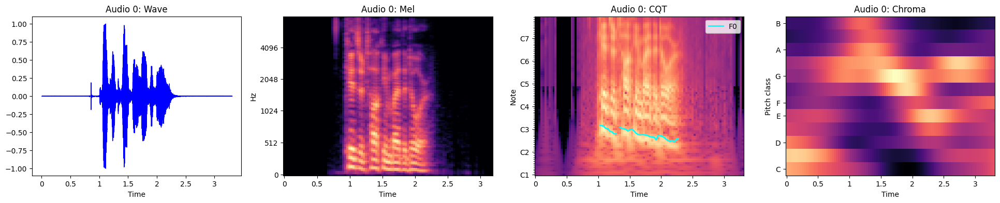

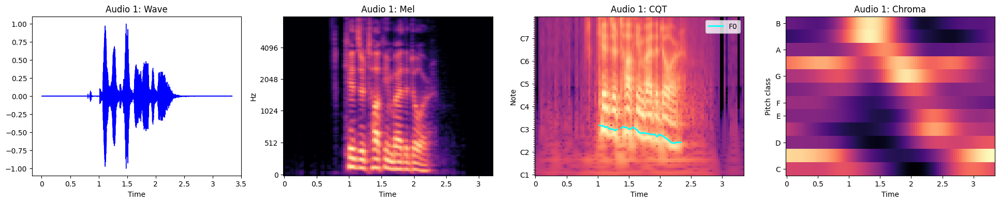

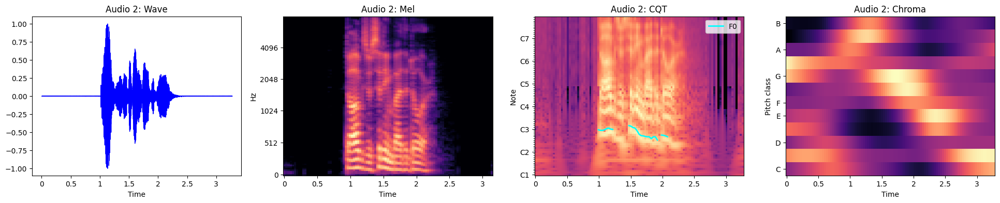

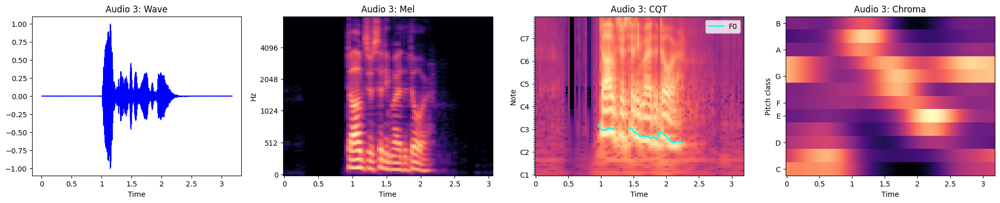

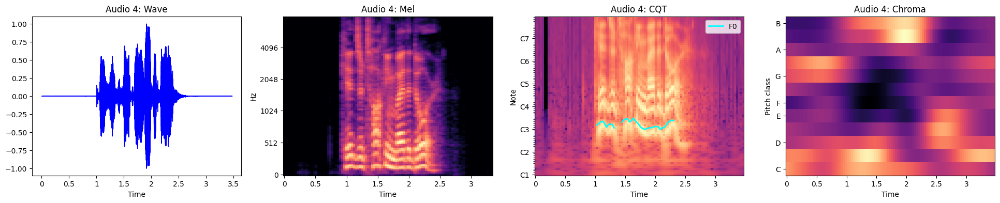

...

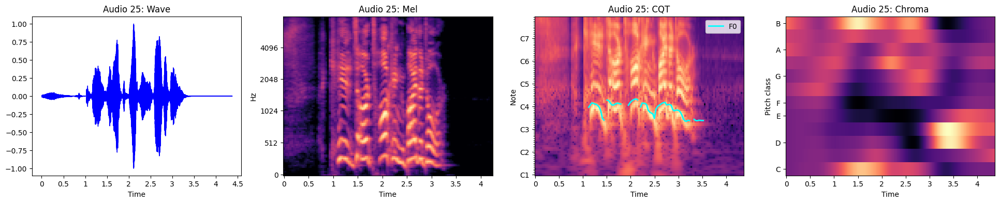

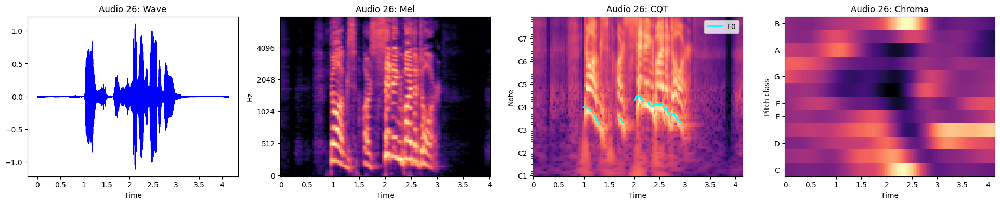

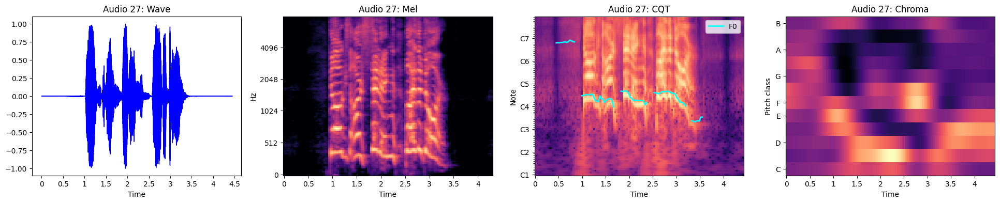

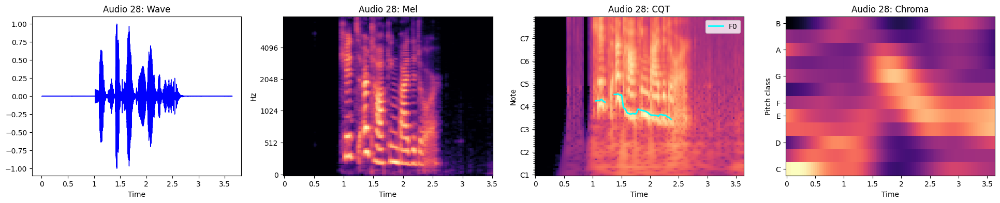

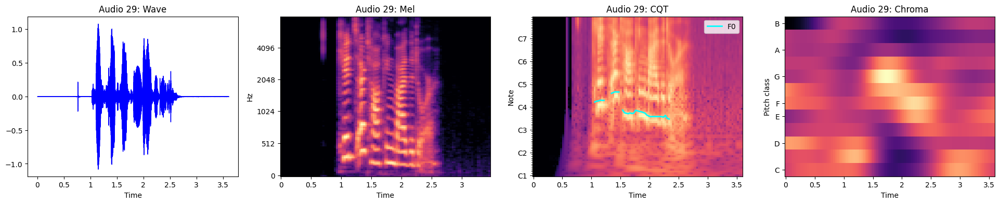

In [155]:
players = display_audio_list(d1['x'].values)
for p in players:
    ipd.display(p)

In [225]:
def mutual_info_check(x, segment_win_size=1024, segment_stride=1024,
                      kernel_size=1024, stride=500, downsampling=8, threshold=0.):
    X = torch.tensor(x, device=device)[None, None, :]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    pad_fn = PadForConv(kernel_size=segment_stride, pad_mode='zero')
    ami = AudioMutualInfo(
        kernel_size=kernel_size, stride=stride, 
        downsampling=downsampling).to(device)
    X = norm_fn(X)
    if segment_stride == segment_win_size:
        filters = rearrange(pad_fn(X), 'b c (h kz) -> (b h) c kz', kz=segment_win_size, c=1)
    else:
        X_pad = pad_fn(X)
        n_filters = X_pad.shape[-1] // segment_stride
        X_pad = F.pad(X_pad, pad=(0, segment_win_size*2), mode='constant', value=0)
        filters_positions = torch.arange(n_filters) * segment_stride
        filters = [X_pad[..., p:p+segment_win_size] for p in filters_positions]
        filters = rearrange(torch.stack(filters, dim=2), 'b c h kz -> (b h) c kz')
    filters = acov_fn(filters)
    filters = norm_fn(filters)
    X_filtered = F.conv1d(X, filters, padding='same')  # b h n
    X_filtered = norm_fn(X_filtered)
    
    out, (_, _) = ami.mutual_information(X_filtered, X)
    out = (out*100).squeeze().round(decimals=0).type(torch.int).tolist()
    return out


In [89]:
d1 = df[:30]

In [184]:
d1.apply(lambda x: 
         print(f"{labels[x['y']]}\t{mutual_info_check(x['x'],kernel_size=1024, stride=500, downsampling=8, threshold=0.)}"), 
         axis=1)

neu	[9, 45, 4, 4, 12, 49, 8, 7, 16, 17, -2, 19, -2, 3, -13, -8, -1, -21, -4, -5, 2, 10, -4, 2, 9, 189, 189, 4, 16, -4, 9, 189, 189, 189, 189, 0, 10, -9, 20, 0, -3, 7, 25, 13, 15, 8, 30, 9, 52, 0, 36, 12]
neu	[22, 10, 49, 13, 14, 16, 44, 19, 11, 12, 4, -1, 8, -12, -7, 1, -20, -1, 1, 23, 193, 2, 1, -6, 6, 2, 193, 2, 14, 3, -13, 11, -15, -1, -16, -8, 6, -11, 0, -13, 10, -8, -1, 16, 40, 27, 32, 14, 12, 48, 55, 36, 41]
neu	[-7, 38, -2, 1, 28, -5, -10, -5, -2, -2, -3, -5, -3, -10, 15, 1, -15, -7, 4, 5, 179, -6, 7, 179, -21, 179, -14, -19, -25, 2, -10, 0, -13, -9, 4, -8, 0, -4, -24, -4, 12, 4, 38, 55, 21, 12, -5, -1, 59, -8, 20, 12]
neu	[2, 13, 4, -3, -5, 11, -7, -17, -12, 2, -7, 11, -12, 2, -10, -13, -6, -8, -16, -19, -36, -10, -41, -46, 176, -20, -14, -41, -28, -10, 1, -15, 16, 176, -5, -24, -9, -2, -1, -1, -8, 77, 81, 16, 0, 8, -15, -7, 0, 5]
hap	[4, 30, 71, 82, 29, 39, -7, 30, 20, 6, 3, -10, -12, 24, -1, 8, 8, 2, 6, 11, 11, 8, 3, -9, 3, -4, -3, 214, -10, -4, 214, 6, -2, -13, -24, -5, 9, 1

0     None
1     None
2     None
3     None
4     None
5     None
6     None
7     None
8     None
9     None
10    None
11    None
12    None
13    None
14    None
15    None
16    None
17    None
18    None
19    None
20    None
21    None
22    None
23    None
24    None
25    None
26    None
27    None
28    None
29    None
dtype: object

In [185]:
d1['mi'] = d1.apply(lambda x: mutual_info_check(x['x'],kernel_size=1024, stride=500, downsampling=8, threshold=0.), axis=1)

In [186]:
d2 = pd.concat([d1[:5], d1[-5:]])
d2

,x,y,mi
0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1,"[9, 45, 4, 4, 12, 49, 8, 7, 16, 17, -2, 19, -2..."
1,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -3.05...",1,"[22, 10, 49, 13, 14, 16, 44, 19, 11, 12, 4, -1..."
2,"[3.0517578e-05, 3.0517578e-05, 3.0517578e-05, ...",1,"[-7, 38, -2, 1, 28, -5, -10, -5, -2, -2, -3, -..."
3,"[3.0517578e-05, 3.0517578e-05, 0.0, 0.0, 0.0, ...",1,"[2, 13, 4, -3, -5, 11, -7, -17, -12, 2, -7, 11..."
4,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",3,"[4, 30, 71, 82, 29, 39, -7, 30, 20, 6, 3, -10,..."
25,"[0.002319336, 0.0021362305, -0.002319336, 0.00...",0,"[194, 39, 34, 80, 111, 50, 24, 127, 113, 54, 4..."
26,"[0.0007324219, 0.0010986328, -0.0006713867, -0...",0,"[112, 101, 124, 130, 133, 105, 75, 78, 19, 78,..."
27,"[0.00033569336, 0.00024414062, 0.00024414062, ...",0,"[105, 77, 18, -4, 43, 97, 179, 113, 82, 123, 9..."
28,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1,"[43, 111, 113, 12, 64, 51, 22, 47, 32, -10, 28..."
29,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1,"[102, 109, 75, 39, 76, 39, 53, 24, 67, 29, 31,..."


In [181]:
def acov_compute(data, position: int, kernel_size=1024):
    if type(data) != Tensor:
        data = torch.tensor(data)
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)    
    windowed_data = data[position:(position + kernel_size)] * torch.hann_window(kernel_size)
    windowed_data = norm_fn(windowed_data)
    spectrum = torch.fft.rfft(windowed_data, n=kernel_size)**2
    acov = torch.fft.ifftshift(torch.fft.irfft(spectrum.real))
    acov = norm_fn(acov)
    return acov

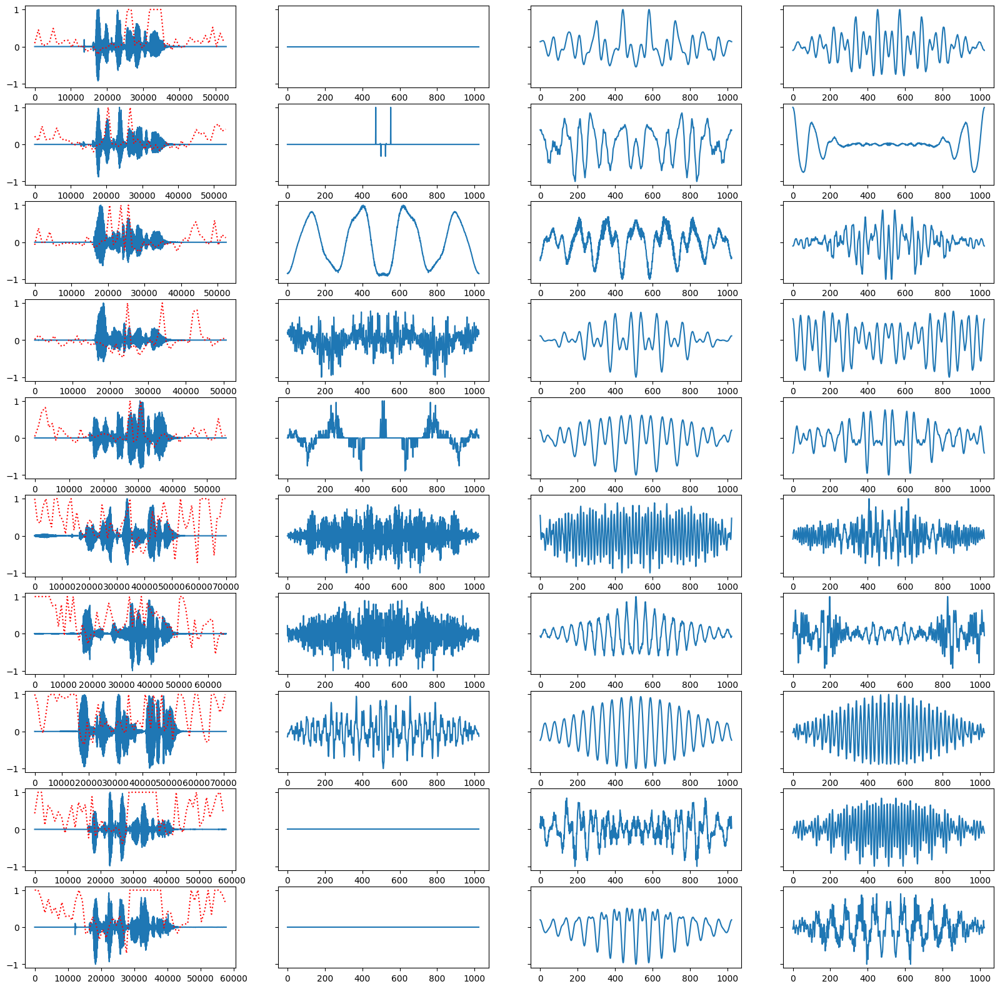

In [187]:
n = len(d2)
kernel_size, stride, downsampling = 1024, 500, 8
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*kernel_size
    mi = [min(v/100, 1) for v in d['mi']]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')
    
    axes[i, 1].plot(acov_compute(d['x'], position=0, kernel_size=kernel_size))
    axes[i, 2].plot(acov_compute(d['x'], position=np.argmax(d['mi'])*kernel_size, kernel_size=kernel_size))
    axes[i, 3].plot(acov_compute(d['x'], position=np.argmin(d['mi'])*kernel_size, kernel_size=kernel_size))

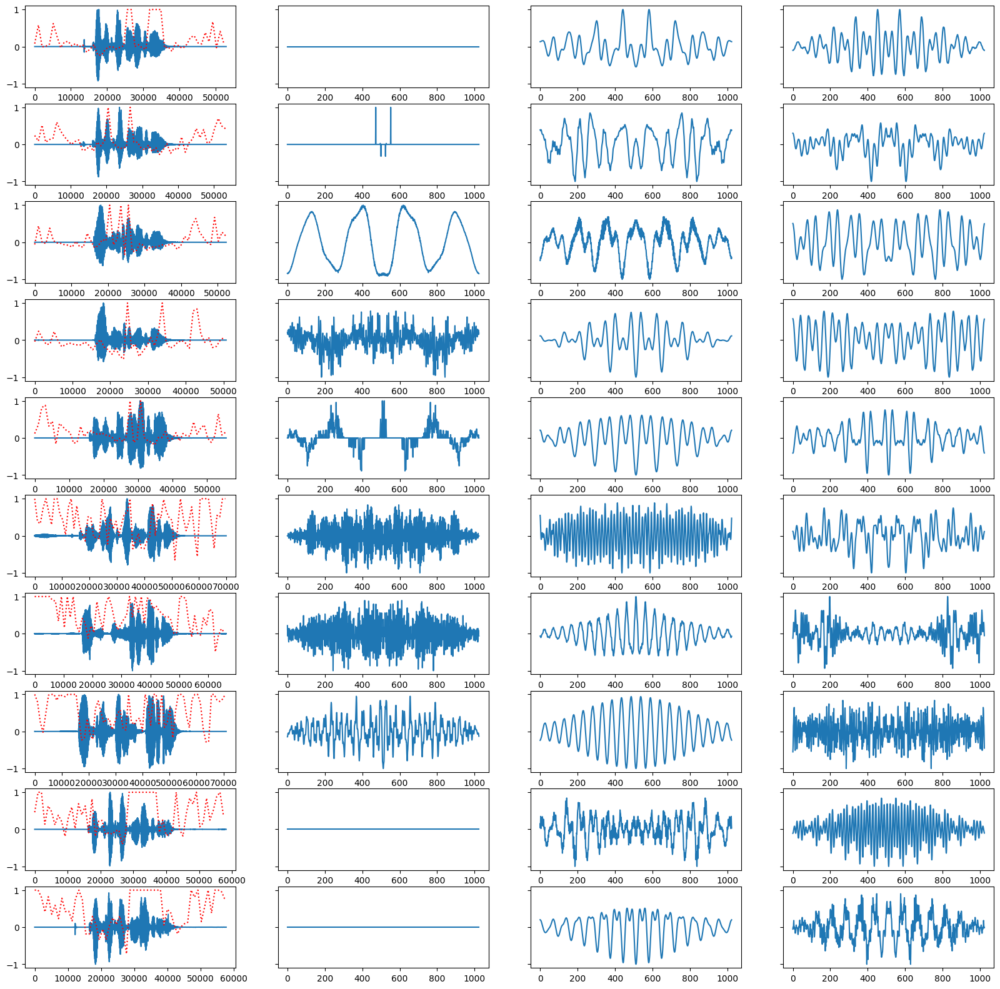

In [191]:
n = len(d2)
segment_win_size, segment_stride = 1024, 1024
kernel_size, stride, downsampling = 512, 250, 16
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_win_size
    mi = [min(v/100, 1) for v in d['mi']]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')
    
    axes[i, 1].plot(acov_compute(d['x'], position=0, kernel_size=segment_win_size))
    axes[i, 2].plot(acov_compute(d['x'], position=np.argmax(d['mi'])*segment_win_size, kernel_size=segment_win_size))
    axes[i, 3].plot(acov_compute(d['x'], position=np.argmin(d['mi'])*segment_win_size, kernel_size=segment_win_size))

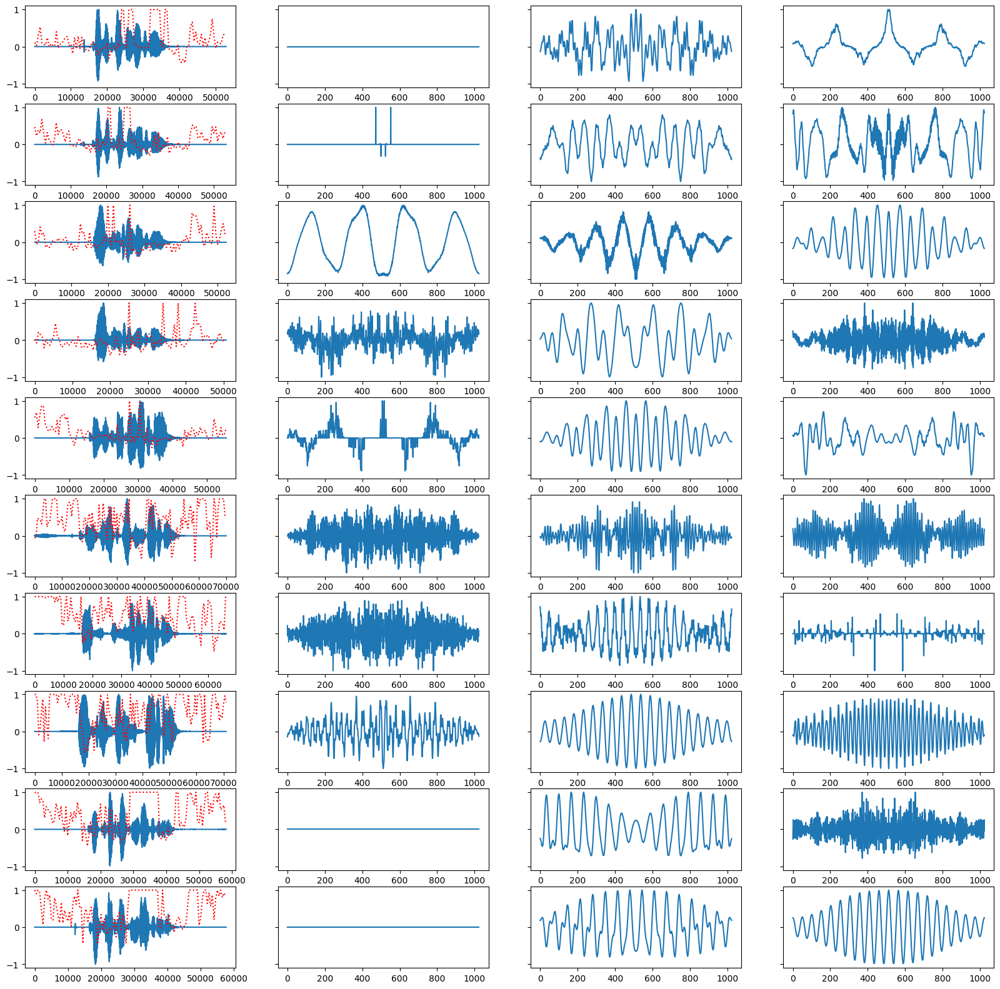

In [227]:
n = len(d2)
segment_win_size, segment_stride = 1024, 500
kernel_size, stride, downsampling = 512, 250, 16
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [min(v/100, 1) for v in d['mi']]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')
    
    axes[i, 1].plot(acov_compute(d['x'], position=0, kernel_size=segment_win_size))
    axes[i, 2].plot(acov_compute(d['x'], position=np.argmax(d['mi'])*segment_stride, kernel_size=segment_win_size))
    axes[i, 3].plot(acov_compute(d['x'], position=np.argmin(d['mi'])*segment_stride, kernel_size=segment_win_size))

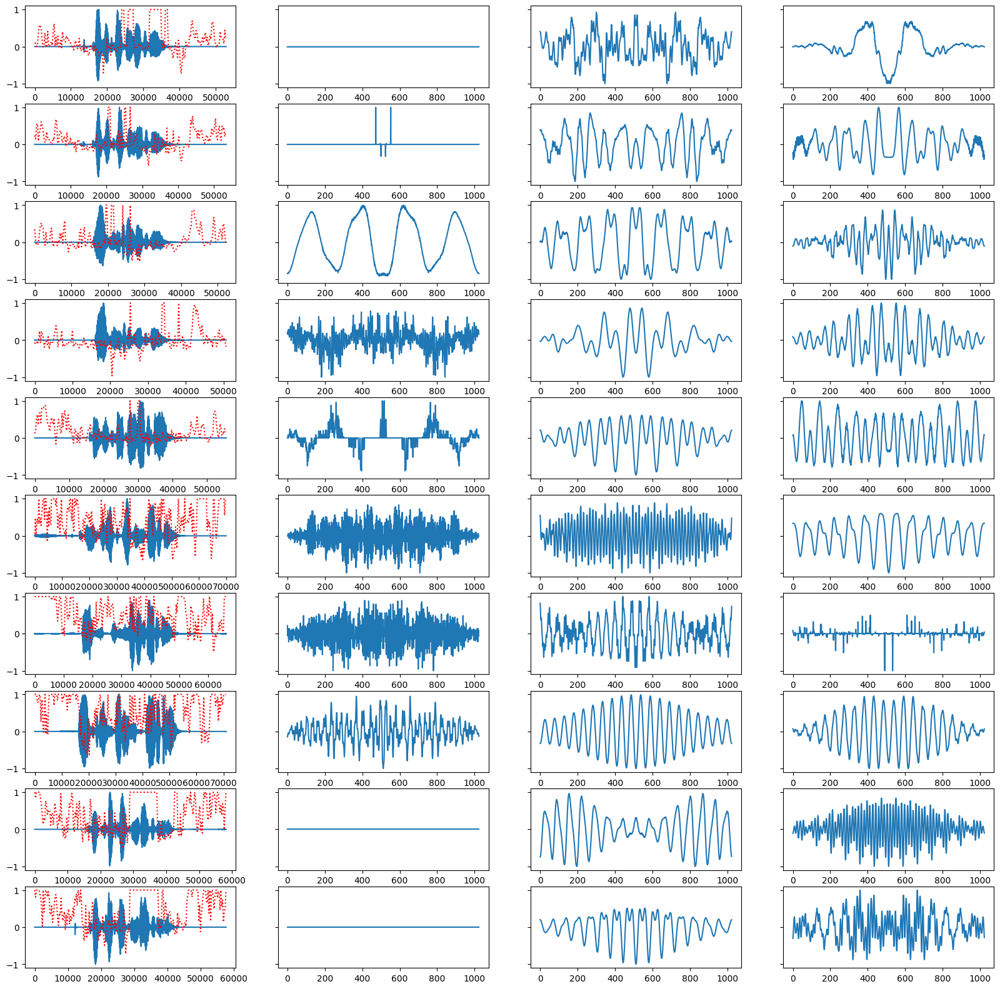

In [228]:
n = len(d2)
segment_win_size, segment_stride = 1024, 256
kernel_size, stride, downsampling = 512, 250, 16
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [min(v/100, 1) for v in d['mi']]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')
    
    axes[i, 1].plot(acov_compute(d['x'], position=0, kernel_size=segment_win_size))
    axes[i, 2].plot(acov_compute(d['x'], position=np.argmax(d['mi'])*segment_stride, kernel_size=segment_win_size))
    axes[i, 3].plot(acov_compute(d['x'], position=np.argmin(d['mi'])*segment_stride, kernel_size=segment_win_size))

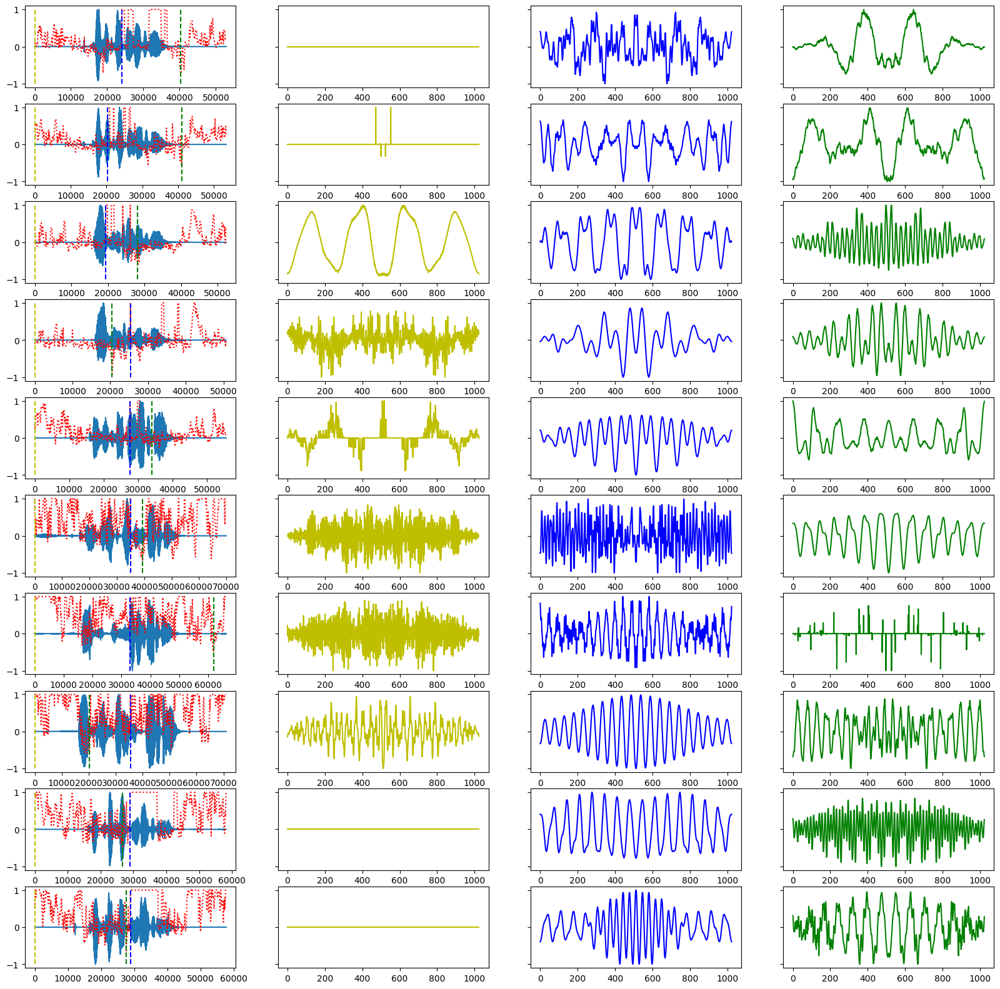

In [232]:
n = len(d2)
segment_win_size, segment_stride = 1024, 128
kernel_size, stride, downsampling = 512, 250, 16
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [min(v/100, 1) for v in d['mi']]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'])*segment_stride, np.argmin(d['mi'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

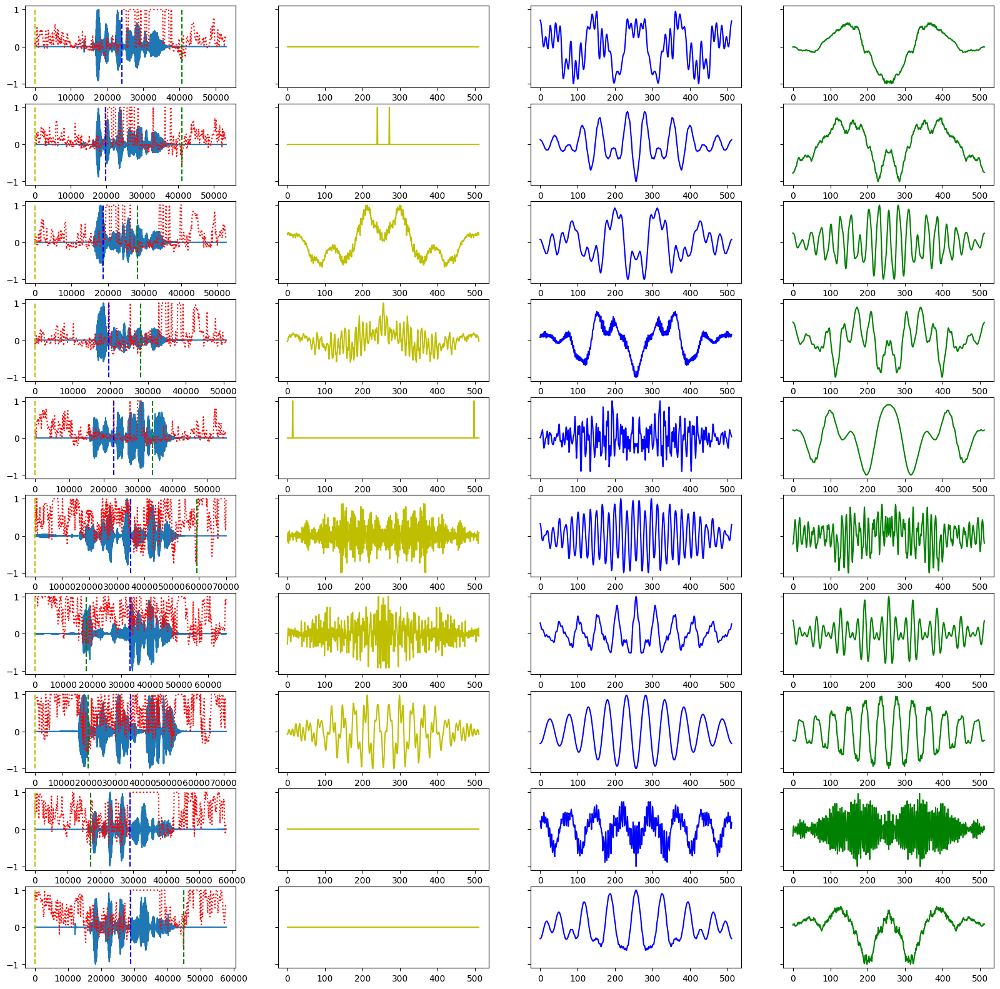

In [274]:
n = len(d2)
segment_win_size, segment_stride = 512, 128
kernel_size, stride, downsampling = 512, 250, 16
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [min(v/100, 1) for v in d['mi']]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'])*segment_stride, np.argmin(d['mi'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

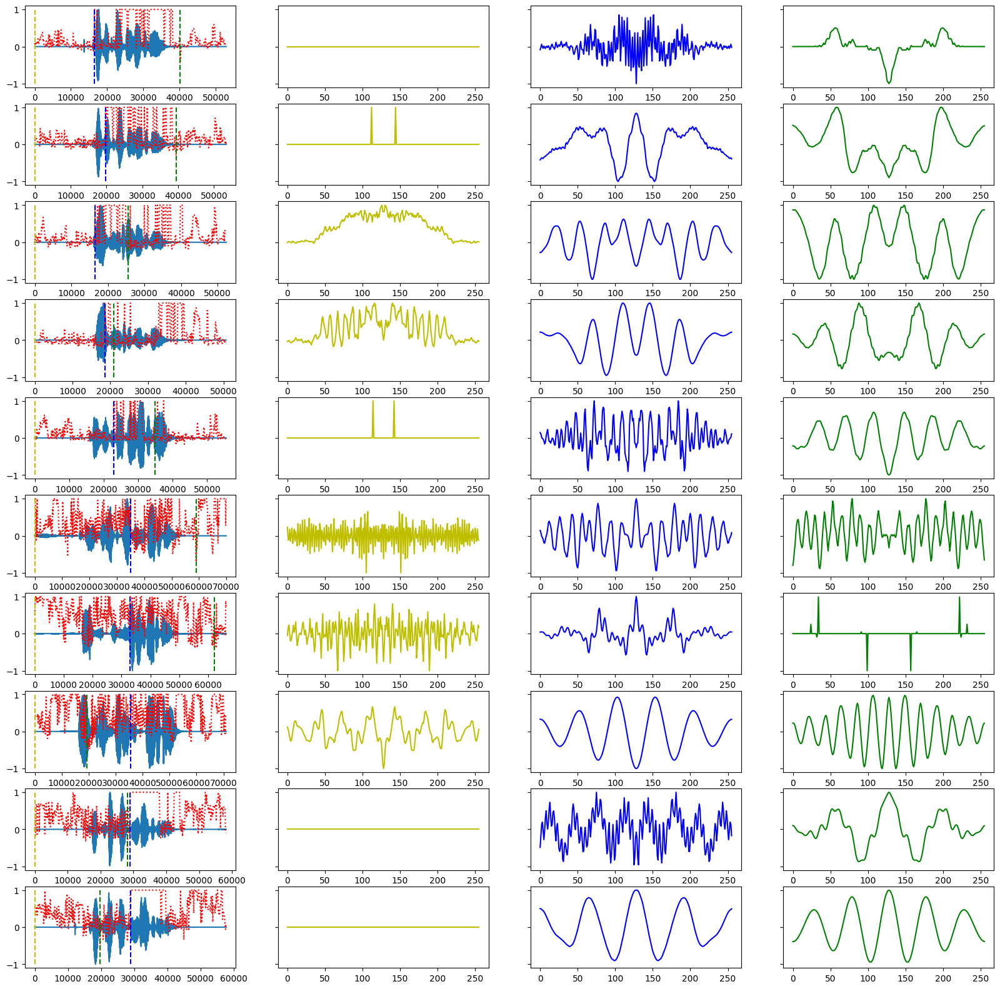

In [275]:
n = len(d2)
segment_win_size, segment_stride = 256, 128
kernel_size, stride, downsampling = 512, 250, 16
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [min(v/100, 1) for v in d['mi']]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'])*segment_stride, np.argmin(d['mi'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

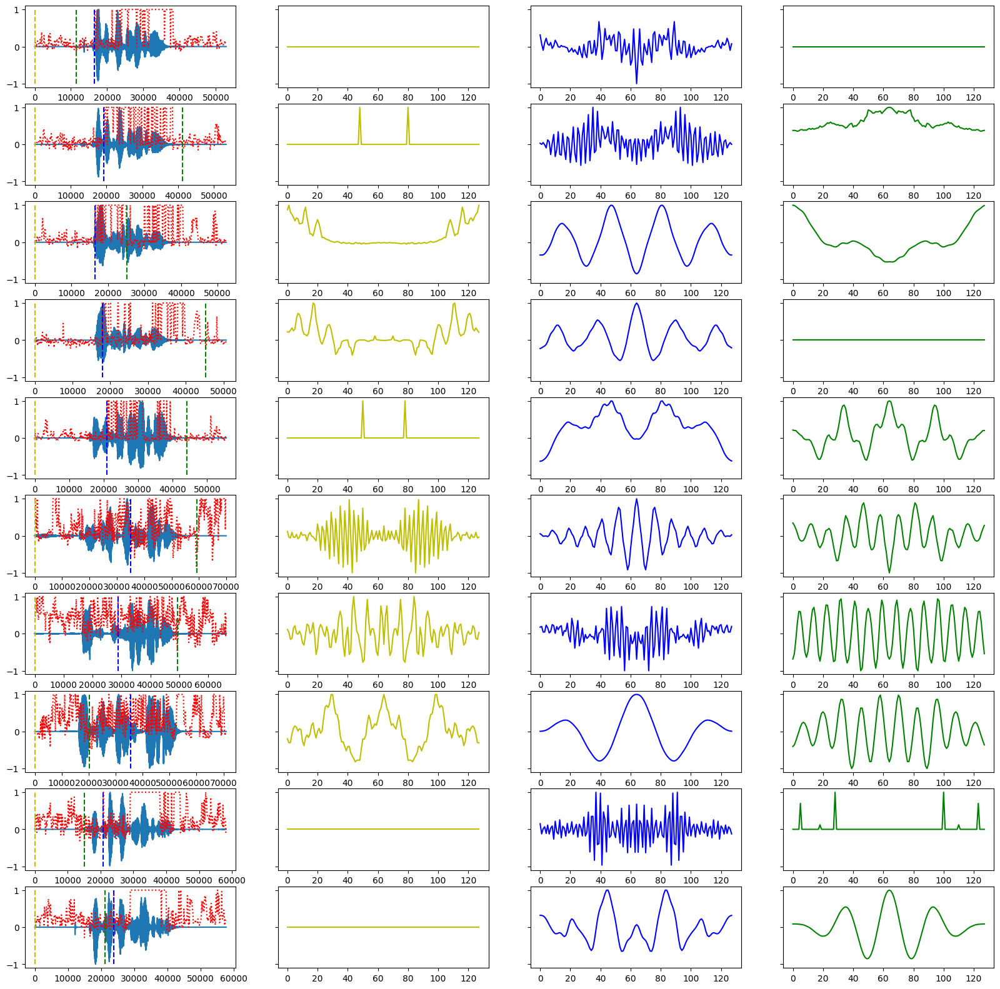

In [276]:
n = len(d2)
segment_win_size, segment_stride = 128, 128
kernel_size, stride, downsampling = 512, 250, 16
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [min(v/100, 1) for v in d['mi']]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'])*segment_stride, np.argmin(d['mi'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

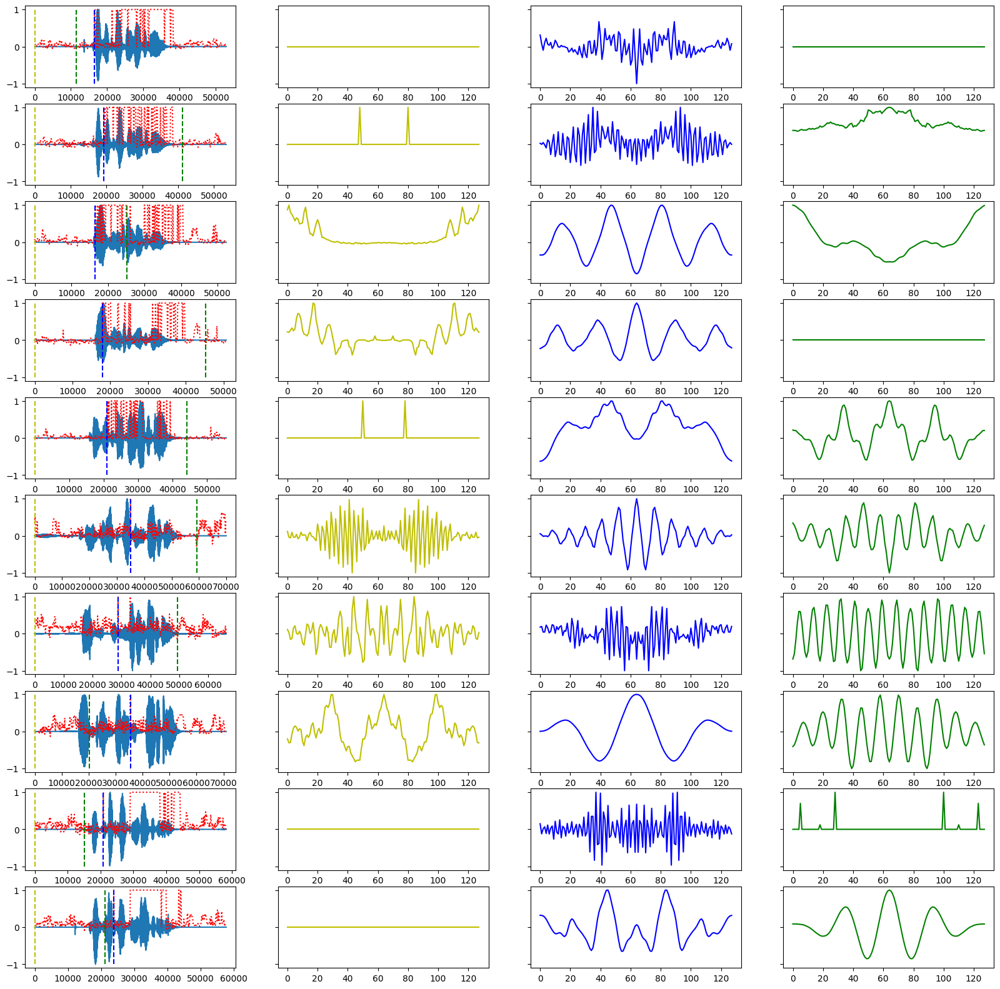

In [278]:
n = len(d2)
segment_win_size, segment_stride = 128, 128
kernel_size, stride, downsampling = 512, 250, 16
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(mi)
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'])*segment_stride, np.argmin(d['mi'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

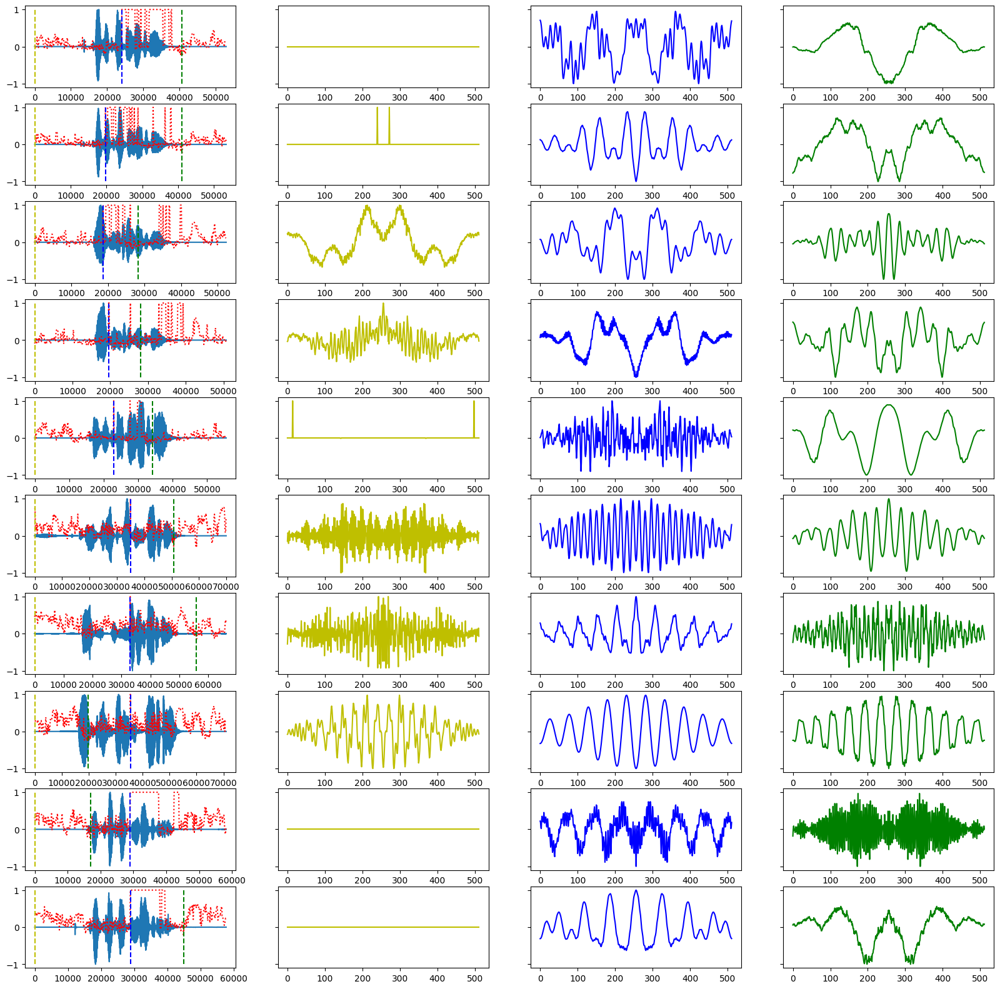

In [280]:
n = len(d2)
segment_win_size, segment_stride = 512, 128
kernel_size, stride, downsampling = 512, 250, 8
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(mi)
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'])*segment_stride, np.argmin(d['mi'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

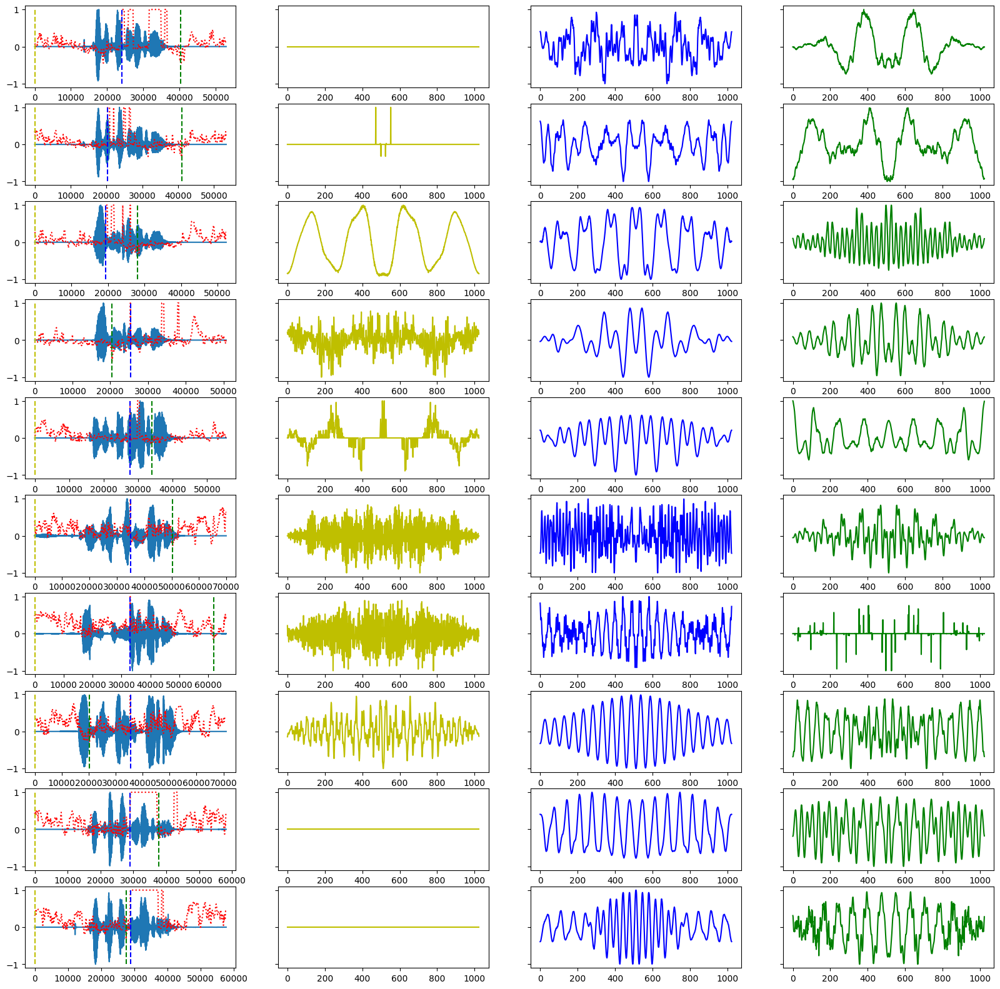

In [281]:
n = len(d2)
segment_win_size, segment_stride = 1024, 128
kernel_size, stride, downsampling = 512, 250, 8
d2['mi'] = d2.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(mi)
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'])*segment_stride, np.argmin(d['mi'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

In [269]:
def mutual_info_check2(x, segment_win_size=1024, segment_stride=1024,
                      kernel_size=1024, stride=500, downsampling=8, threshold=0.):
    X = torch.tensor(x, device=device)[None, None, :]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    pad_fn = PadForConv(kernel_size=segment_stride, pad_mode='zero')
    ami = AudioMutualInfo(
        kernel_size=kernel_size, stride=stride, 
        downsampling=downsampling).to(device)
    X = norm_fn(X)
    if segment_stride == segment_win_size:
        filters = rearrange(pad_fn(X), 'b c (h kz) -> (b h) c kz', kz=segment_win_size, c=1)
    else:
        X_pad = pad_fn(X)
        n_filters = X_pad.shape[-1] // segment_stride
        X_pad = F.pad(X_pad, pad=(0, segment_win_size*2), mode='constant', value=0)
        filters_positions = torch.arange(n_filters) * segment_stride
        filters = [X_pad[..., p:p+segment_win_size] for p in filters_positions]
        filters = rearrange(torch.stack(filters, dim=2), 'b c h kz -> (b h) c kz')
    filters = acov_fn(filters)
    filters = norm_fn(filters)
    X_filtered = F.conv1d(X, filters, padding='same')  # b h n
    X_filtered = norm_fn(X_filtered)

    px = ami.compute_probs(X)
    px_cz = ami.compute_probs(X_filtered)
    out = reduce(px.ge(px_cz), 'b c n -> b c', 'all').squeeze().type(torch.int).tolist()
    return out


In [270]:
d1.apply(lambda x: print(mutual_info_check2(x['x'])), axis=1)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

0     None
1     None
2     None
3     None
4     None
5     None
6     None
7     None
8     None
9     None
10    None
11    None
12    None
13    None
14    None
15    None
16    None
17    None
18    None
19    None
20    None
21    None
22    None
23    None
24    None
25    None
26    None
27    None
28    None
29    None
dtype: object

In [271]:
d1.apply(lambda x: sum(mutual_info_check2(x['x'])), axis=1)

0      6
1      2
2      3
3      4
4      4
5      2
6      4
7      6
8      5
9      4
10    11
11     4
12     9
13     3
14    12
15     9
16     4
17     8
18    10
19     8
20     6
21     7
22     4
23     3
24     7
25     7
26    18
27    14
28    11
29    13
dtype: int64

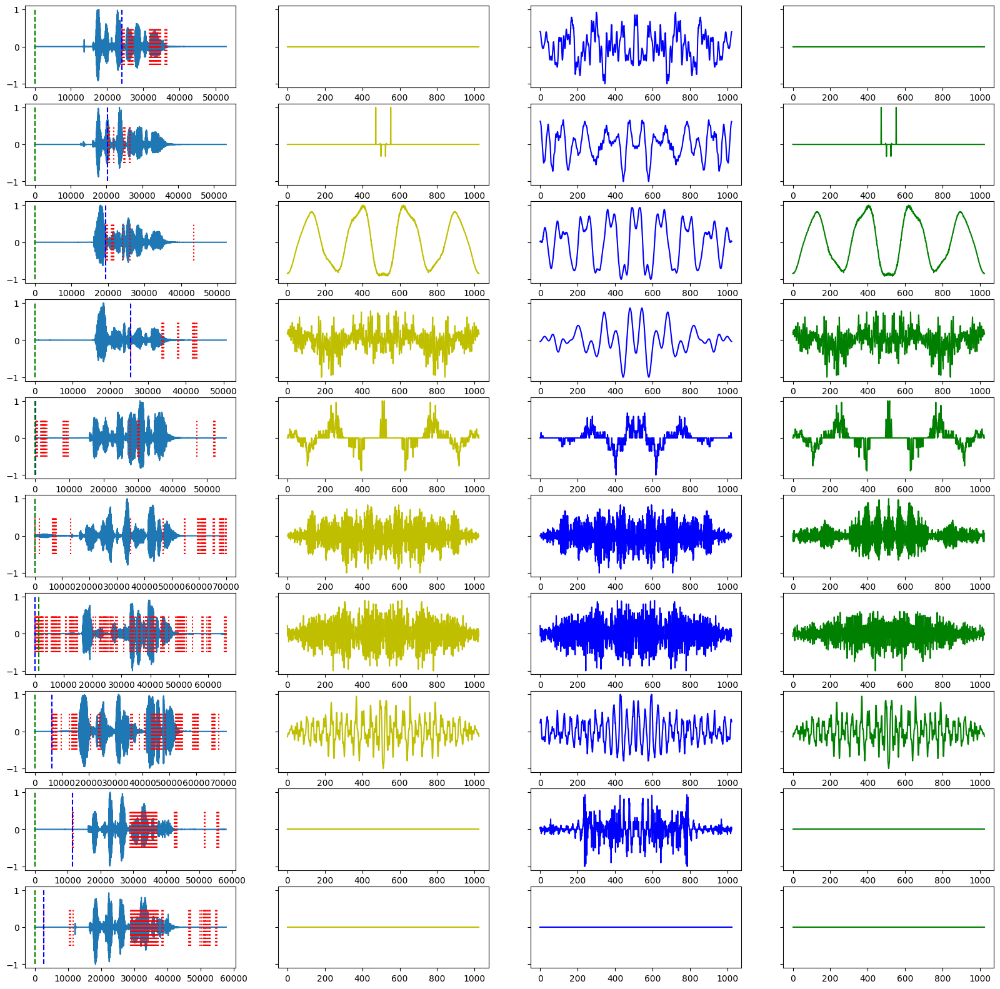

In [272]:
n = len(d2)
segment_win_size, segment_stride = 1024, 128
kernel_size, stride, downsampling = 512, 250, 16
d2['mi2'] = d2.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

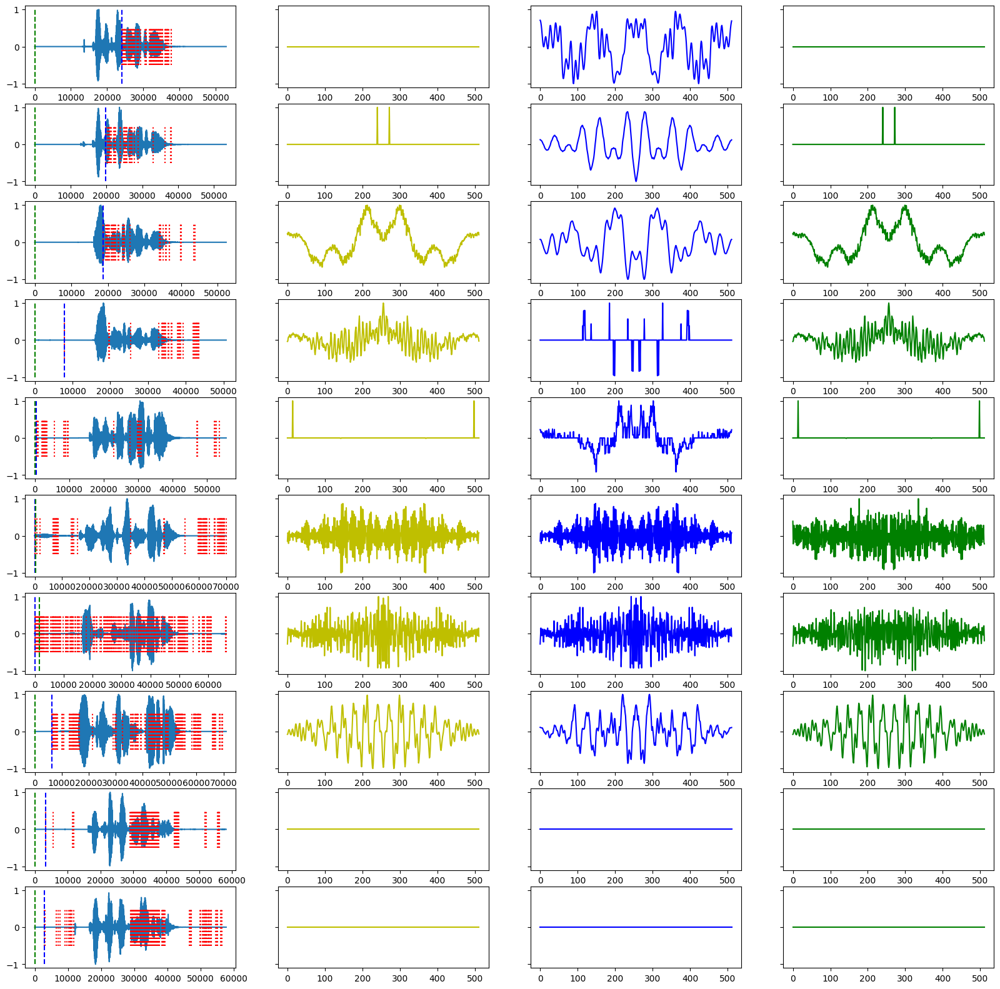

In [273]:
n = len(d2)
segment_win_size, segment_stride = 512, 128
kernel_size, stride, downsampling = 512, 250, 16
d2['mi2'] = d2.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

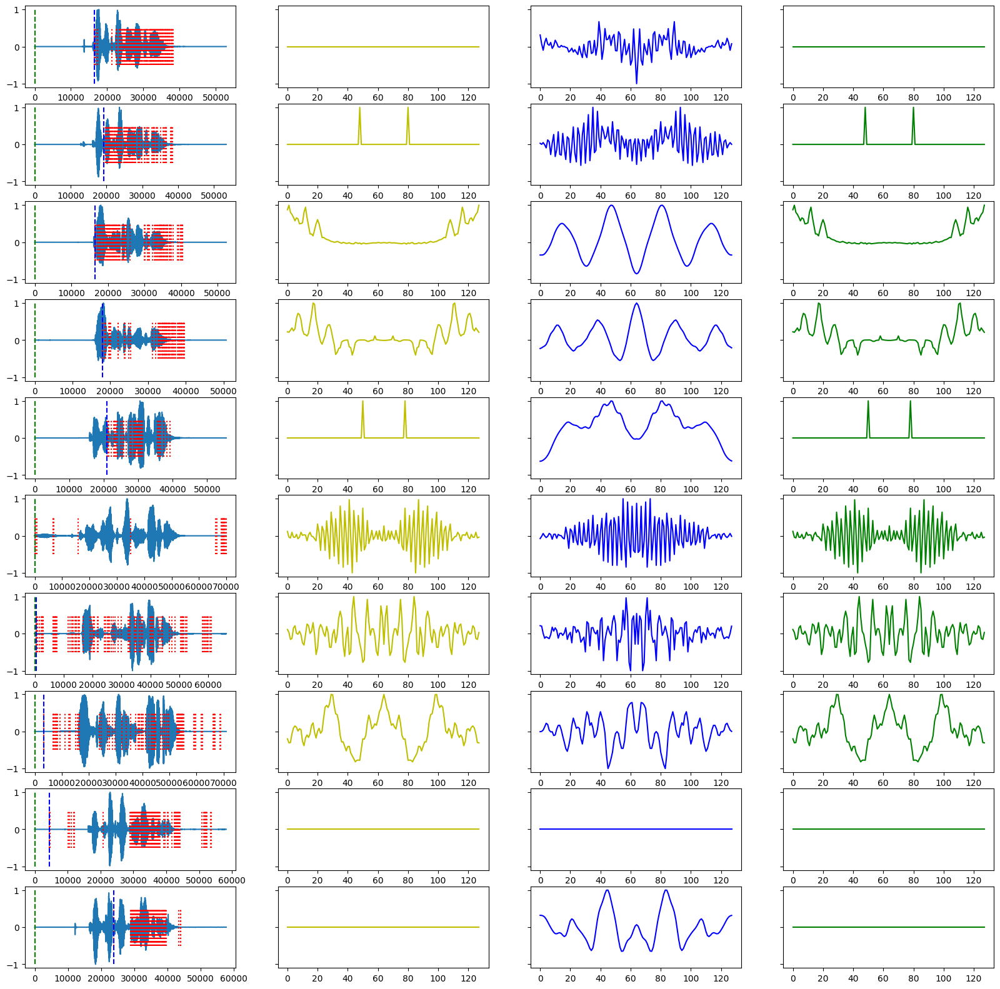

In [282]:
n = len(d2)
segment_win_size, segment_stride = 128, 128
kernel_size, stride, downsampling = 512, 250, 8
d2['mi2'] = d2.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

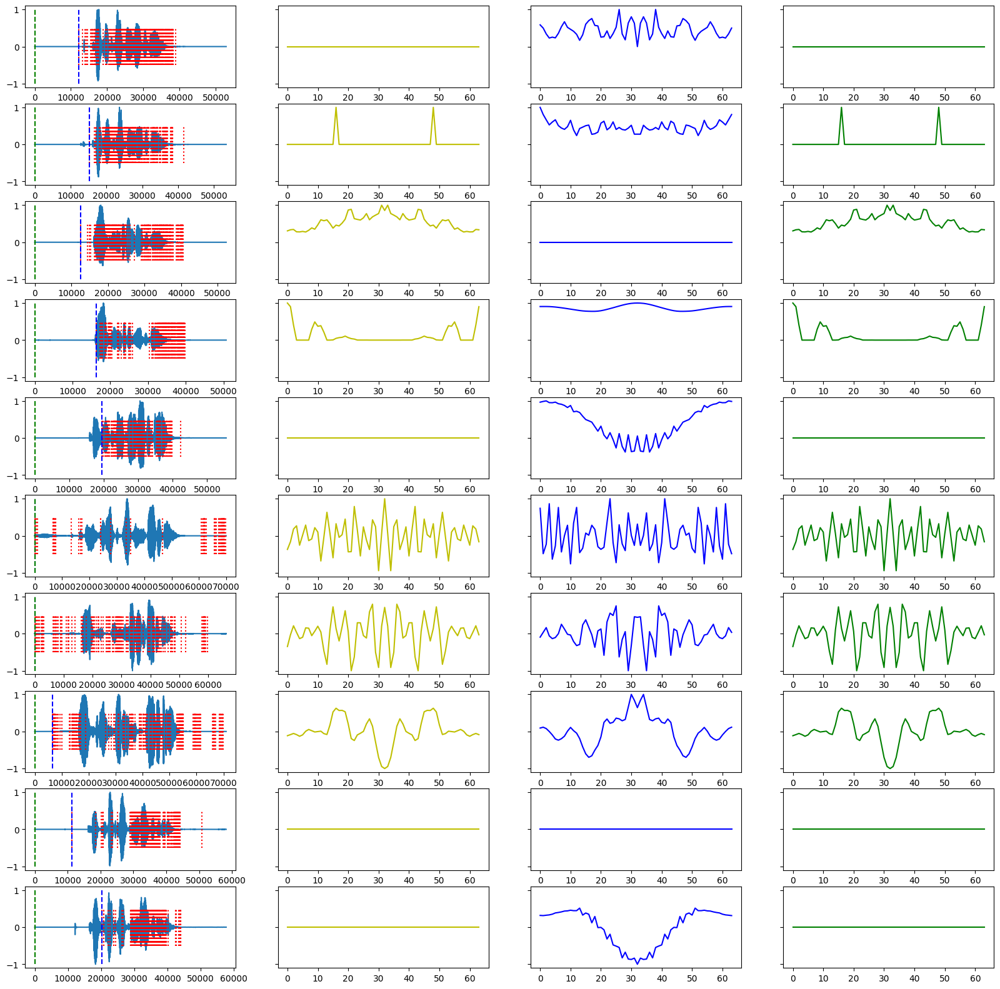

In [284]:
n = len(d2)
segment_win_size, segment_stride = 64, 64
kernel_size, stride, downsampling = 512, 250, 8
d2['mi2'] = d2.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

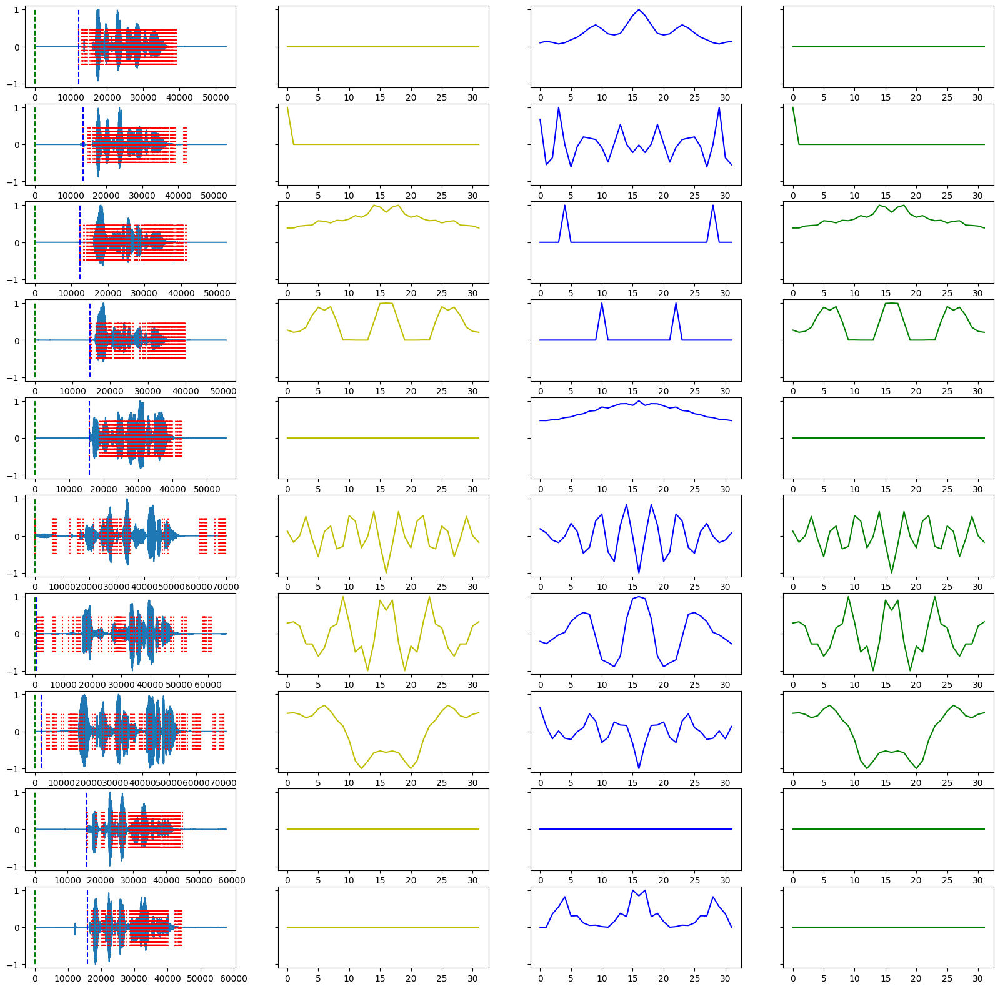

In [285]:
n = len(d2)
segment_win_size, segment_stride = 32, 64
kernel_size, stride, downsampling = 512, 250, 8
d2['mi2'] = d2.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

In [293]:
def mutual_info_check4(x, segment_win_size=1024, segment_stride=1024,
                      kernel_size=1024, stride=500, downsampling=8, threshold=0.):
    X = torch.tensor(x, device=device)[None, None, :]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    pad_fn = PadForConv(kernel_size=segment_stride, pad_mode='zero')
    ami = AudioMutualInfo(
        kernel_size=kernel_size, stride=stride, 
        downsampling=downsampling).to(device)
    X = norm_fn(X)
    if segment_stride == segment_win_size:
        filters = rearrange(pad_fn(X), 'b c (h kz) -> (b h) c kz', kz=segment_win_size, c=1)
    else:
        X_pad = pad_fn(X)
        n_filters = X_pad.shape[-1] // segment_stride
        X_pad = F.pad(X_pad, pad=(0, segment_win_size*2), mode='constant', value=0)
        filters_positions = torch.arange(n_filters) * segment_stride
        filters = [X_pad[..., p:p+segment_win_size] for p in filters_positions]
        filters = rearrange(torch.stack(filters, dim=2), 'b c h kz -> (b h) c kz')
    filters = acov_fn(filters)
    filters = norm_fn(filters)
    X_filtered = F.conv1d(X, filters, padding='same')  # b h n
    X_filtered = norm_fn(X_filtered)

    px = ami.compute_probs(X)
    px_cz = ami.compute_probs(X_filtered)
    px = reduce(px.ge(px_cz), 'b c n -> b c', 'all').squeeze()
    px_cz = reduce(px_cz, 'b c n -> b c', 'mean').squeeze() > 0
    out = torch.logical_and(px, px_cz).type(torch.int).tolist()
    return out


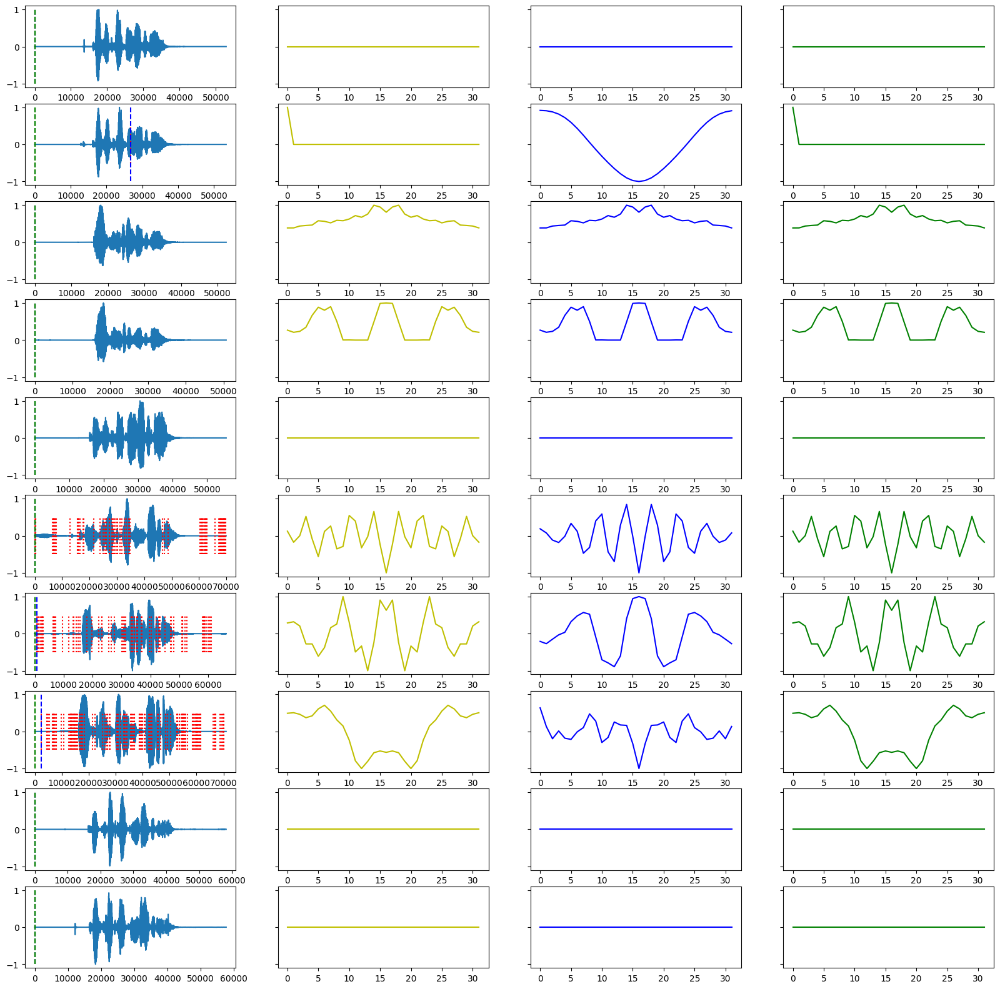

In [292]:
n = len(d2)
segment_win_size, segment_stride = 32, 64
kernel_size, stride, downsampling = 512, 250, 8
d2['mi2'] = d2.apply(lambda x: mutual_info_check4(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

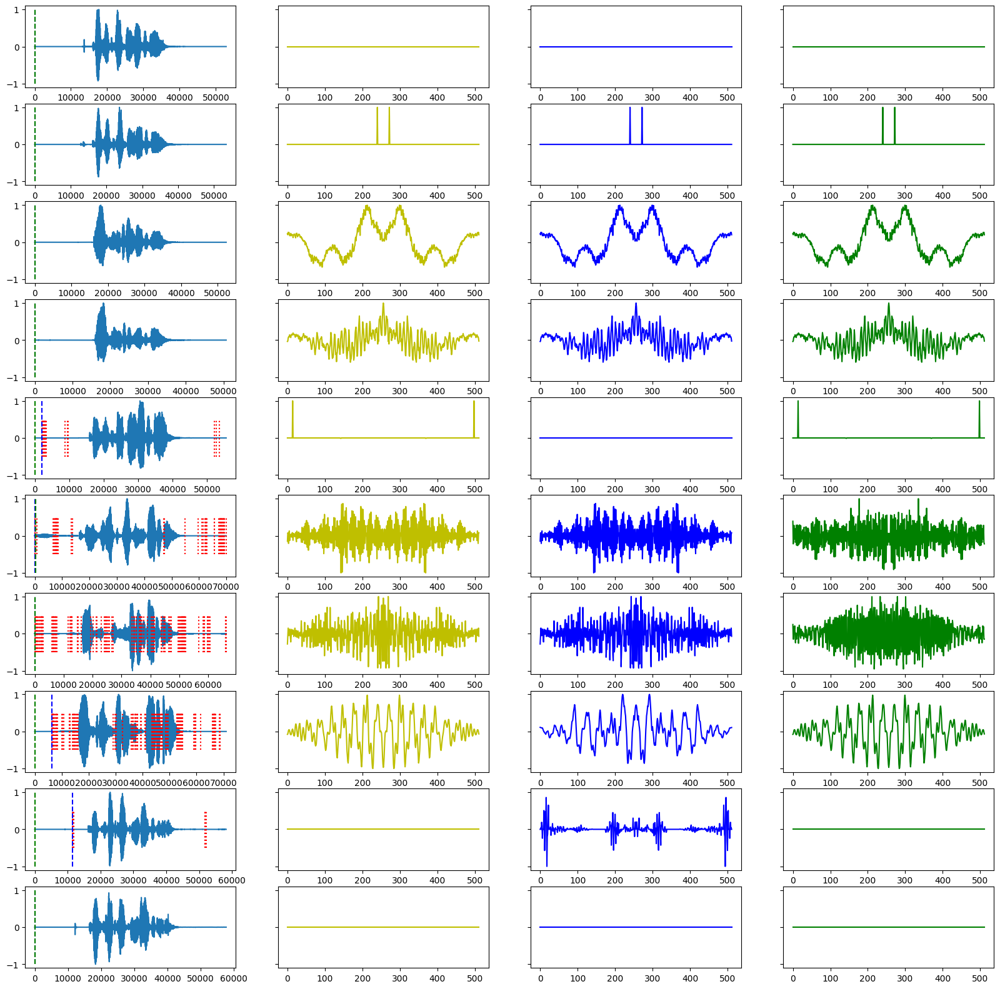

In [290]:
n = len(d2)
segment_win_size, segment_stride = 512, 128
kernel_size, stride, downsampling = 512, 250, 8
d2['mi2'] = d2.apply(lambda x: mutual_info_check4(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

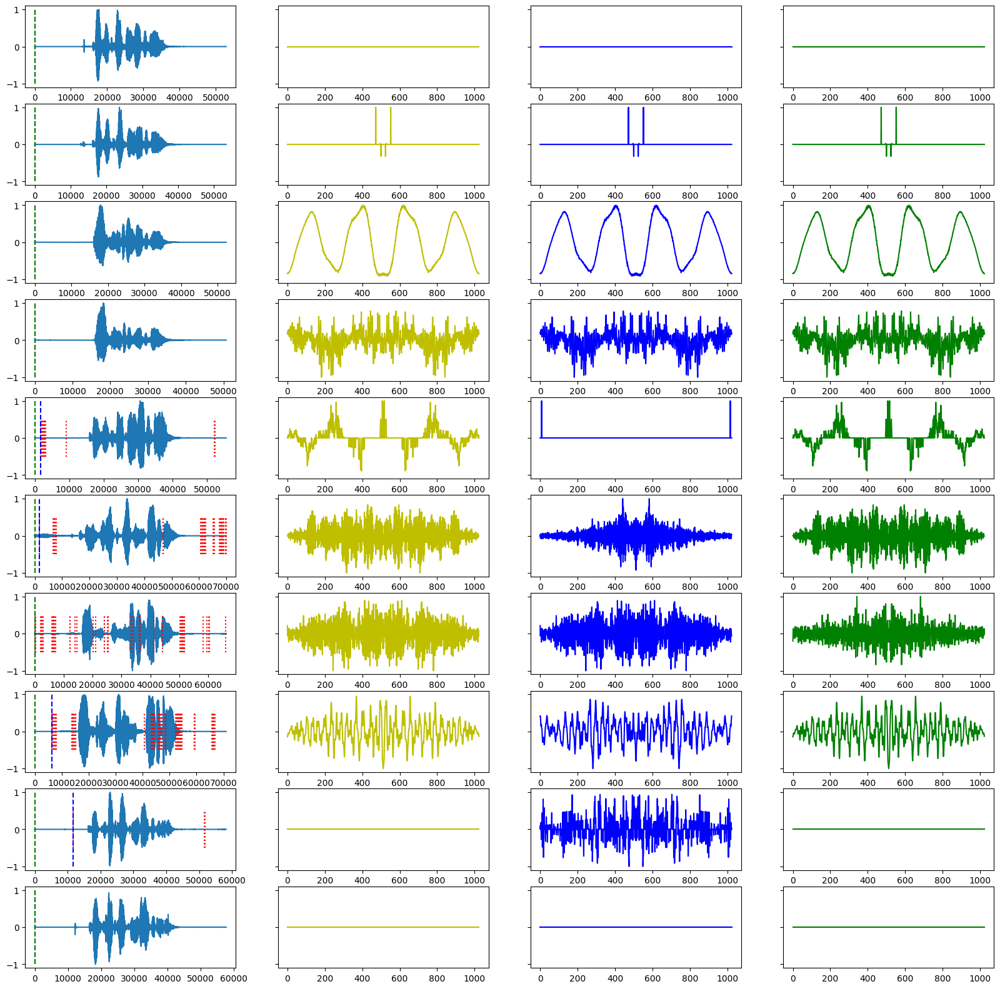

In [294]:
n = len(d2)
segment_win_size, segment_stride = 1024, 128
kernel_size, stride, downsampling = 512, 250, 8
d2['mi2'] = d2.apply(lambda x: mutual_info_check4(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

In [295]:
def autocovariance(filters: Tensor) -> Tensor:
    eps = torch.finfo(filters.dtype).eps
    n = filters.shape[-1]
    filters = filters / torch.clamp(
        filters.abs().amax(dim=-1, keepdim=True), min=eps)
    win = torch.hann_window(
        window_length=n, 
        dtype=filters.dtype, 
        device=filters.device).reshape(1,1,-1)
    windowed_data = filters * win
    spectrum = torch.fft.rfft(windowed_data, n=n*2)**2
    acov = torch.fft.ifftshift(
        torch.fft.irfft(spectrum.real, n=n*2))
    return acov

In [296]:
def mutual_info_check5(x, segment_win_size=1024, segment_stride=1024,
                      kernel_size=1024, stride=500, downsampling=8, threshold=0., acov_fn=acov_fn):
    X = torch.tensor(x, device=device)[None, None, :]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    pad_fn = PadForConv(kernel_size=segment_stride, pad_mode='zero')
    ami = AudioMutualInfo(
        kernel_size=kernel_size, stride=stride, 
        downsampling=downsampling).to(device)
    X = norm_fn(X)
    if segment_stride == segment_win_size:
        filters = rearrange(pad_fn(X), 'b c (h kz) -> (b h) c kz', kz=segment_win_size, c=1)
    else:
        X_pad = pad_fn(X)
        n_filters = X_pad.shape[-1] // segment_stride
        X_pad = F.pad(X_pad, pad=(0, segment_win_size*2), mode='constant', value=0)
        filters_positions = torch.arange(n_filters) * segment_stride
        filters = [X_pad[..., p:p+segment_win_size] for p in filters_positions]
        filters = rearrange(torch.stack(filters, dim=2), 'b c h kz -> (b h) c kz')
    filters = acov_fn(filters)
    filters = norm_fn(filters)
    X_filtered = F.conv1d(X, filters, padding='same')  # b h n
    X_filtered = norm_fn(X_filtered)

    px = ami.compute_probs(X)
    px_cz = ami.compute_probs(X_filtered)
    px = reduce(px.ge(px_cz), 'b c n -> b c', 'all').squeeze()
    px_cz = reduce(px_cz, 'b c n -> b c', 'mean').squeeze() > 0
    out = torch.logical_and(px, px_cz).type(torch.int).tolist()
    return out


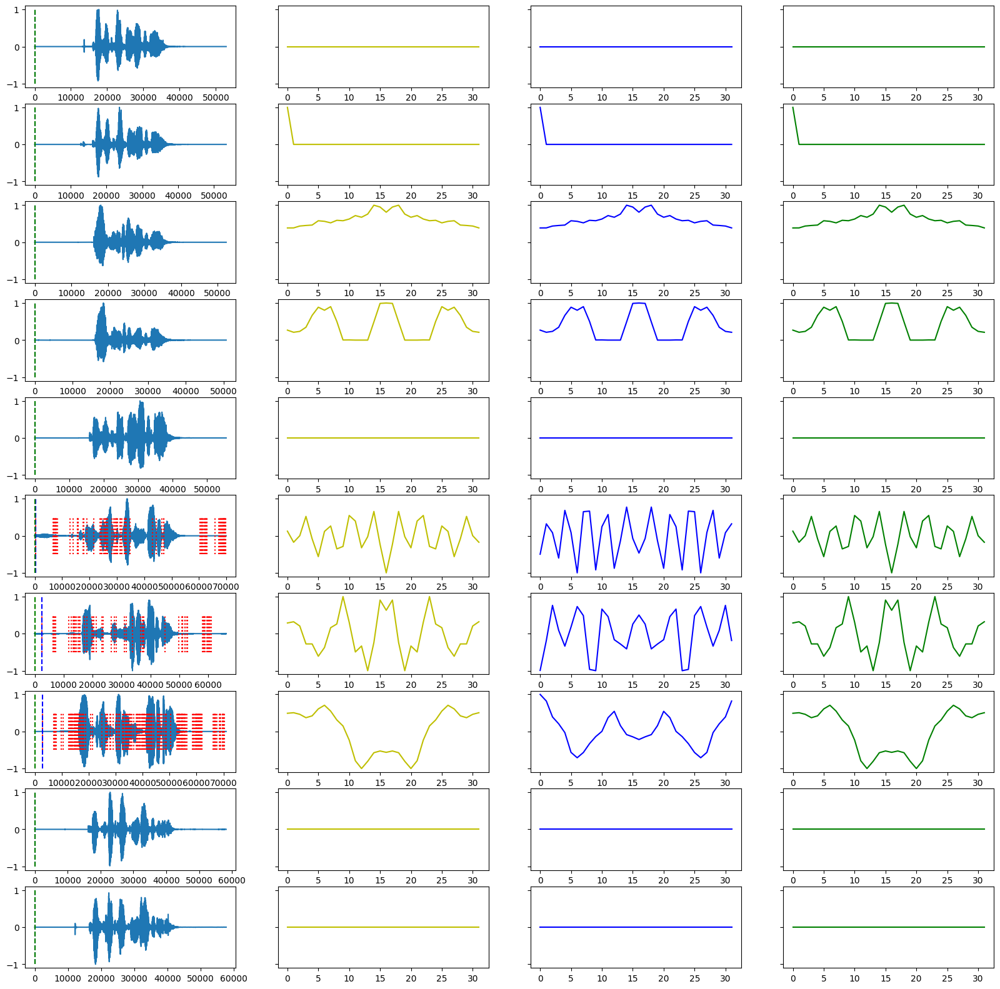

In [297]:
n = len(d2)
segment_win_size, segment_stride = 32, 64
kernel_size, stride, downsampling = 512, 250, 8
d2['mi2'] = d2.apply(lambda x: mutual_info_check5(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0., acov_fn=autocovariance), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

In [267]:
def mutual_info_check3(x, segment_win_size=1024, segment_stride=1024,
                      kernel_size=1024, stride=500, downsampling=8, threshold=0.):
    X = torch.tensor(x, device=device)[None, None, :]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    pad_fn = PadForConv(kernel_size=segment_stride, pad_mode='zero')
    ami = AudioMutualInfo(
        kernel_size=kernel_size, stride=stride, 
        downsampling=downsampling).to(device)
    X = norm_fn(X)
    if segment_stride == segment_win_size:
        filters = rearrange(pad_fn(X), 'b c (h kz) -> (b h) c kz', kz=segment_win_size, c=1)
    else:
        X_pad = pad_fn(X)
        n_filters = X_pad.shape[-1] // segment_stride
        X_pad = F.pad(X_pad, pad=(0, segment_win_size*2), mode='constant', value=0)
        filters_positions = torch.arange(n_filters) * segment_stride
        filters = [X_pad[..., p:p+segment_win_size] for p in filters_positions]
        filters = rearrange(torch.stack(filters, dim=2), 'b c h kz -> (b h) c kz')
    filters = acov_fn(filters)
    filters = norm_fn(filters)
    X_filtered = F.conv1d(X, filters, padding='same')  # b h n
    X_filtered = norm_fn(X_filtered)

    px = ami.compute_probs(X)
    px_cz = ami.compute_probs(X_filtered)
    out = reduce(px.ge(px_cz).type(torch.float), 'b c n -> b c', 'mean').squeeze().tolist()
    return out


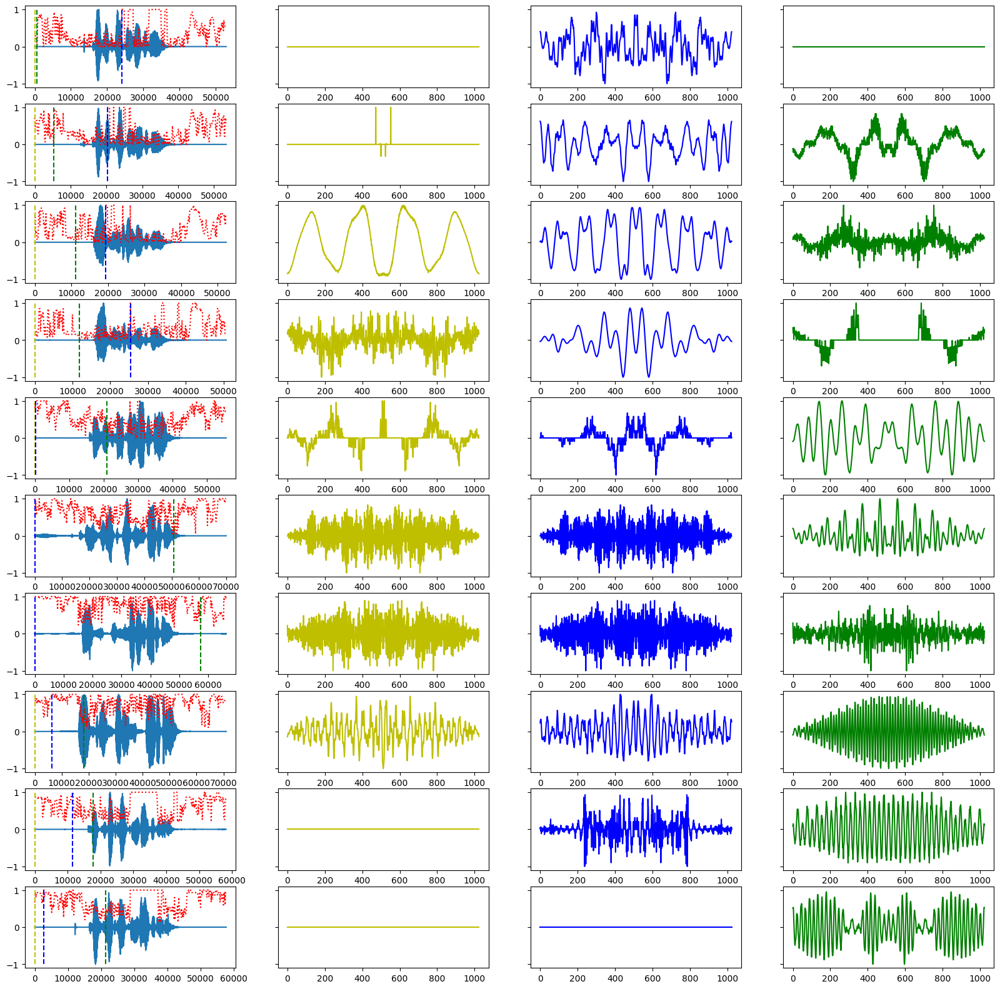

In [268]:
n = len(d2)
segment_win_size, segment_stride = 1024, 128
kernel_size, stride, downsampling = 512, 250, 16
d2['mi3'] = d2.apply(lambda x: mutual_info_check3(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi3']))*segment_stride
    mi = d['mi3']
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi3'])*segment_stride, np.argmin(d['mi3'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

In [308]:
def mutual_info_check6(x, segment_win_size=1024, segment_stride=1024,
                      kernel_size=1024, stride=500, downsampling=8, threshold=0.):
    X = torch.tensor(x, device=device)[None, None, :]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    pad_fn = PadForConv(kernel_size=segment_stride, pad_mode='zero')
    ami = AudioMutualInfo(
        kernel_size=kernel_size, stride=stride, 
        downsampling=downsampling).to(device)
    X = norm_fn(X)
    if segment_stride == segment_win_size:
        filters = rearrange(pad_fn(X), 'b c (h kz) -> (b h) c kz', kz=segment_win_size, c=1)
    else:
        X_pad = pad_fn(X)
        n_filters = X_pad.shape[-1] // segment_stride
        X_pad = F.pad(X_pad, pad=(0, segment_win_size*2), mode='constant', value=0)
        filters_positions = torch.arange(n_filters) * segment_stride
        filters = [X_pad[..., p:p+segment_win_size] for p in filters_positions]
        filters = rearrange(torch.stack(filters, dim=2), 'b c h kz -> (b h) c kz')
    filters = acov_fn(filters)
    filters = norm_fn(filters)
    X_filtered = F.conv1d(X, filters, padding='same')  # b h n
    X_filtered = norm_fn(X_filtered)

    px = ami.compute_probs(X)
    px_cz = ami.compute_probs(X_filtered)
    cond1 = px.lt(px_cz)
    cond2 = px > 0
    cond3 = torch.logical_and(torch.logical_and(cond2.ge(cond1), px_cz > 0), cond1)
    out = reduce(cond3.type(torch.float), 'b c n -> b c', 'mean').squeeze().tolist()
    return out


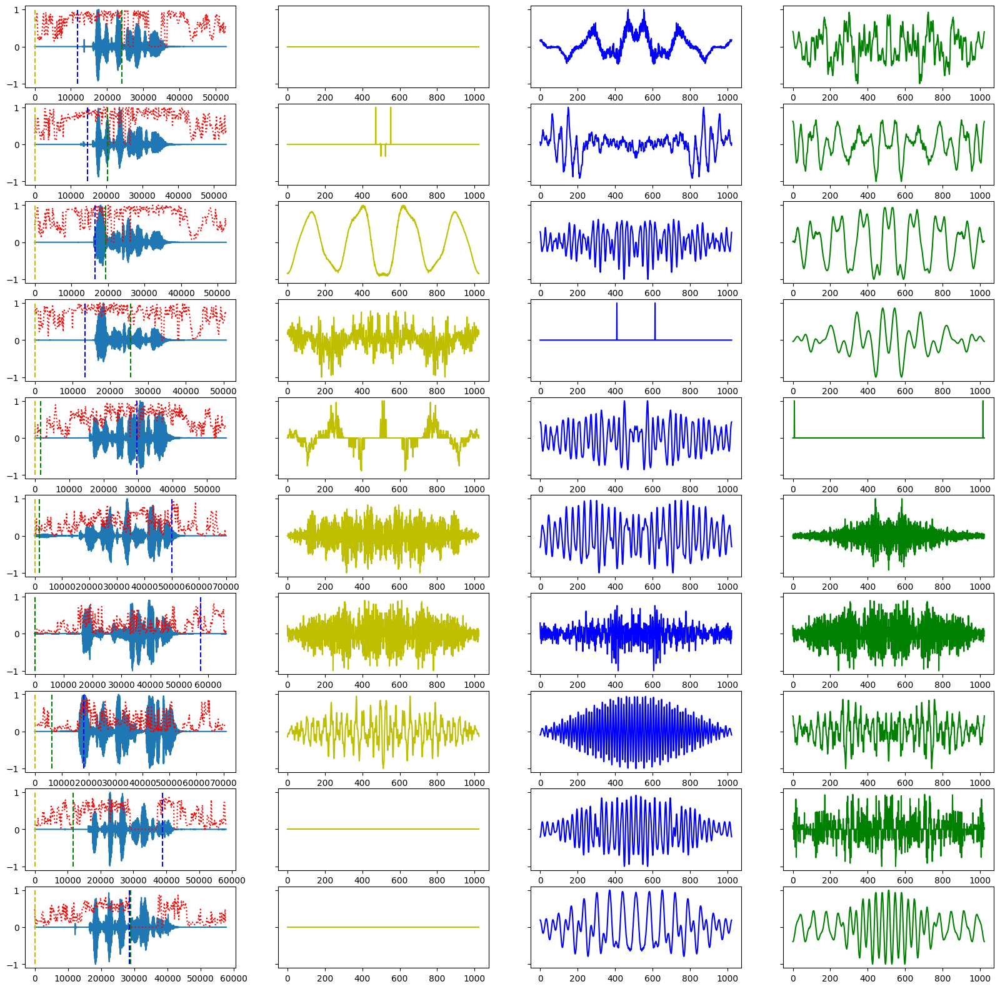

In [309]:
n = len(d2)
segment_win_size, segment_stride = 1024, 128
kernel_size, stride, downsampling = 512, 250, 8
d2['mi3'] = d2.apply(lambda x: mutual_info_check6(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi3']))*segment_stride
    mi = d['mi3']
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi3'])*segment_stride, np.argmin(d['mi3'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

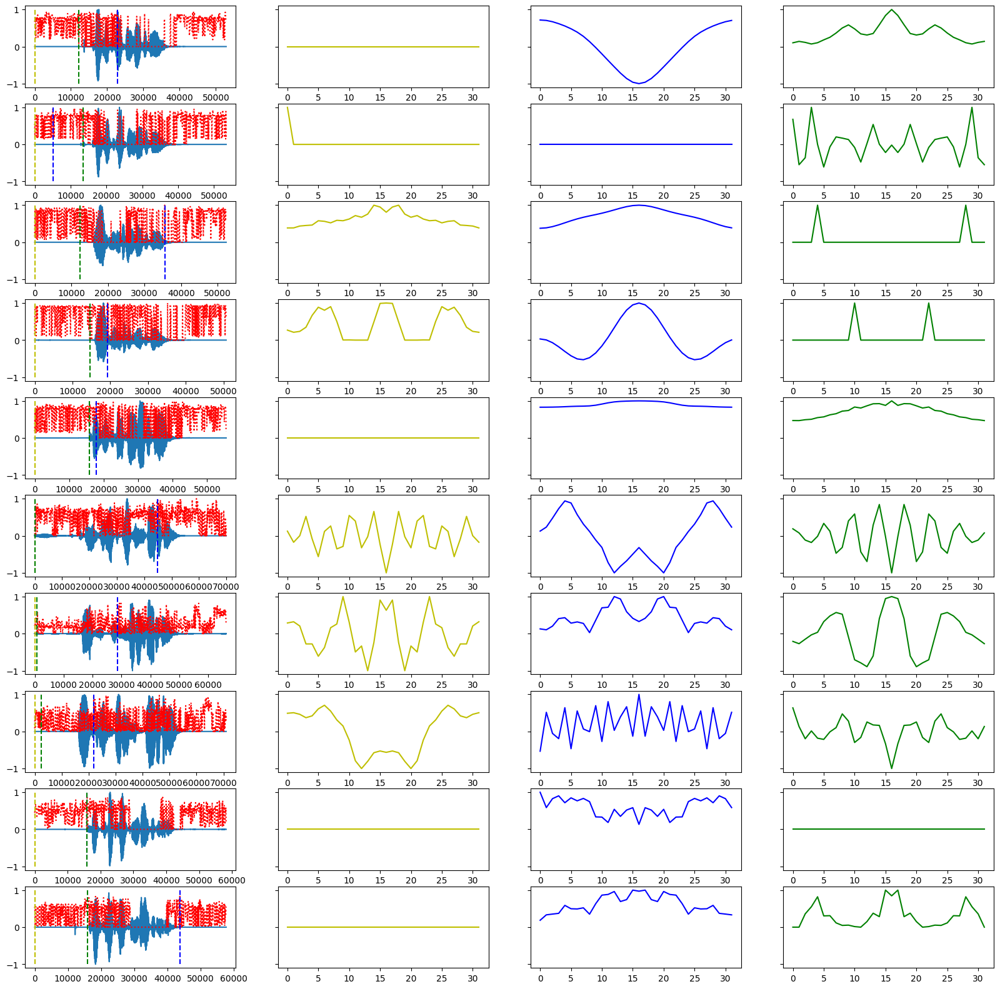

In [310]:
n = len(d2)
segment_win_size, segment_stride = 32, 64
kernel_size, stride, downsampling = 512, 250, 8
d2['mi3'] = d2.apply(lambda x: mutual_info_check6(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi3']))*segment_stride
    mi = d['mi3']
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi3'])*segment_stride, np.argmin(d['mi3'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

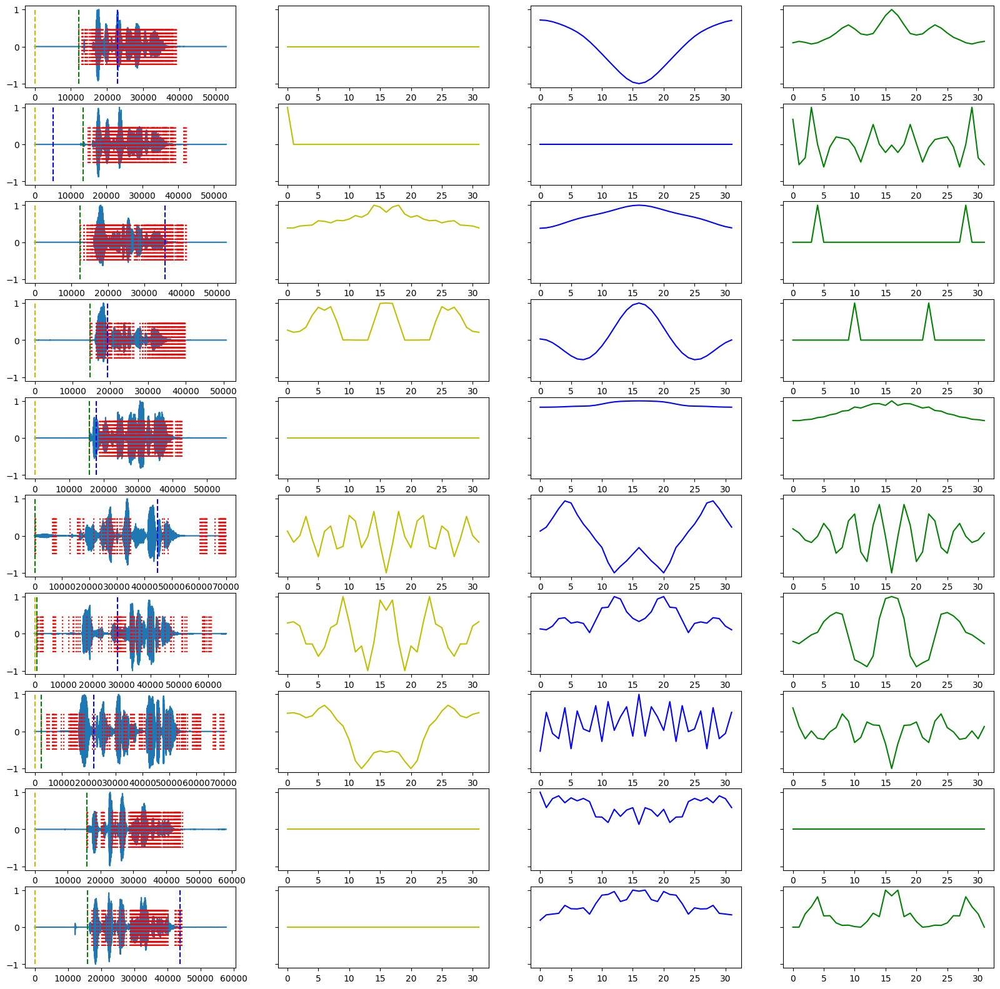

In [311]:
n = len(d2)
segment_win_size, segment_stride = 32, 64
kernel_size, stride, downsampling = 512, 250, 8
d2['mi3'] = d2.apply(lambda x: mutual_info_check6(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi3']))*segment_stride
    mi = d['mi3']
    for j, m in enumerate(mi):
        if m == 0:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi3'])*segment_stride, np.argmin(d['mi3'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

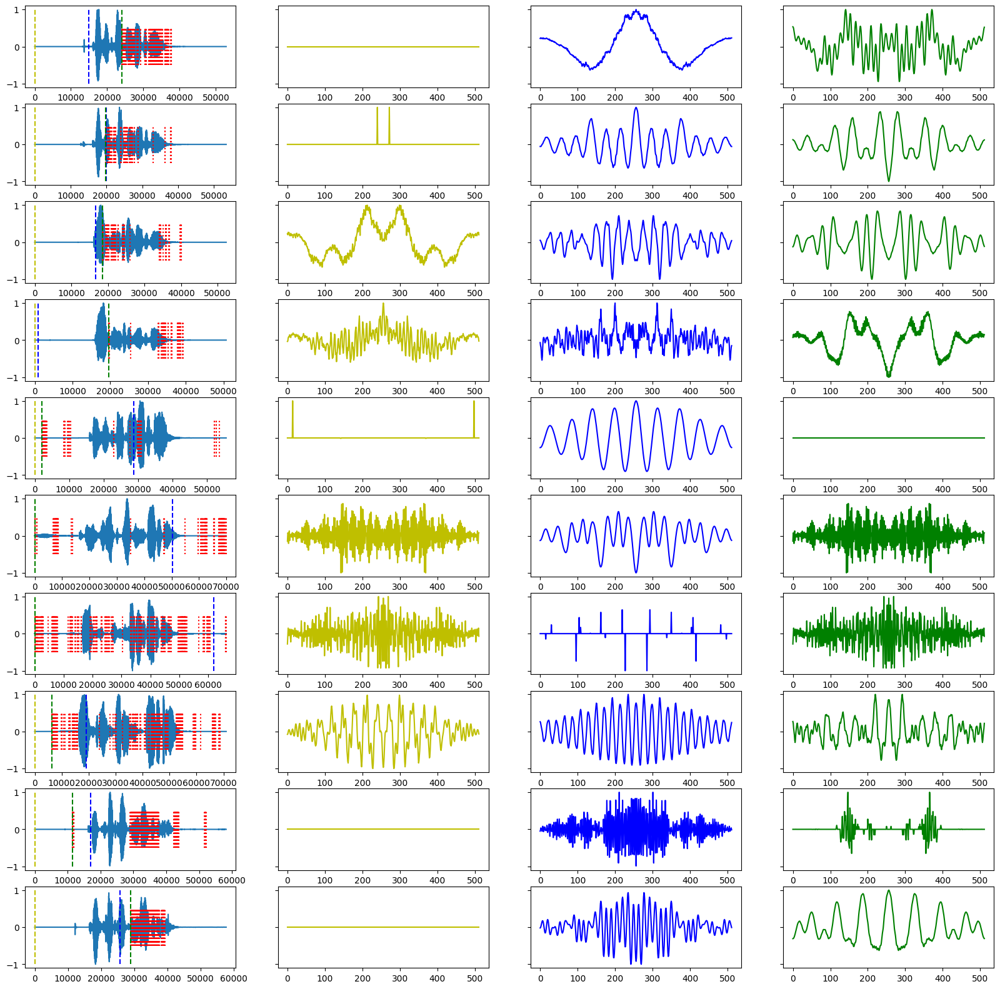

In [312]:
n = len(d2)
segment_win_size, segment_stride = 512, 64
kernel_size, stride, downsampling = 512, 250, 8
d2['mi3'] = d2.apply(lambda x: mutual_info_check6(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi3']))*segment_stride
    mi = d['mi3']
    for j, m in enumerate(mi):
        if m == 0:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi3'])*segment_stride, np.argmin(d['mi3'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

In [313]:
data_dir_meld = '../data/data_preprocessed/meld/features_4balanced/meld.'
sr = 16000

data_x_meld = np.load(f'{data_dir_meld}audio16k.npy', allow_pickle=True)
data_y_meld = np.load(f'{data_dir_meld}label_emotion.npy', allow_pickle=True)
print(data_x_meld.shape)
print(data_y_meld.shape)
np.unique(data_y_meld)

(8499,)
(8499,)


array([0, 1, 2, 3])

In [314]:
classnames_meld = ['ang', 'hap', 'neu', 'sad']

In [315]:
def label_filter_meld(idx):
    return classnames_meld[idx] in labels

def label_to_index_meld(idx):
    return labels.index(classnames_meld[idx])
    
filtered_idx_meld = [label_filter_meld(idx) for idx in data_y_meld]
data_x_meld = data_x_meld[filtered_idx_meld]
data_y_meld = [label_to_index_meld(idx) for idx in data_y_meld[filtered_idx_meld]]
print(data_x_meld.shape)

(8499,)


In [317]:
from sklearn.model_selection import train_test_split

x_train_meld, x_test_meld, y_train_meld, y_test_meld = train_test_split(
    data_x_meld, data_y_meld, test_size=0.2, 
    random_state=42, stratify=data_y_meld)
del x_train_meld, y_train_meld
print("Test: %i" % len(x_test_meld))

Test: 1700


In [319]:
x_train_meld, x_test_meld, y_train_meld, y_test_meld = train_test_split(
    x_test_meld, y_test_meld, test_size=0.2, 
    random_state=42, stratify=y_test_meld)
del x_train_meld, y_train_meld
print("Test: %i" % len(x_test_meld))

Test: 340


In [320]:
data_dir_iemocap = '../data/data_preprocessed/iemocap/preprocessing/iemocap.'
sr = 16000

data_x_iemocap = np.load(f'{data_dir_iemocap}audio16k.npy', allow_pickle=True)
data_y_iemocap = np.load(f'{data_dir_iemocap}label4.npy', allow_pickle=True)
# classnames = np.load(f'{data_dir}iemocap.classnames.npy', allow_pickle=True)
print(data_x_iemocap.shape)
print(data_y_iemocap.shape)
# print(classnames)
np.unique(data_y_iemocap)

(4936,)
(4936,)


array(['ang', 'hap', 'neu', 'sad'], dtype=object)

In [321]:
def label_filter_iemocap(idx):
    return idx in labels

def label_to_index_iemocap(idx):
    return labels.index(idx)
    
filtered_idx_iemocap = [label_filter_iemocap(idx) for idx in data_y_iemocap]
data_x_iemocap = data_x_iemocap[filtered_idx_iemocap]
data_y_iemocap = [label_to_index_iemocap(idx) for idx in data_y_iemocap[filtered_idx_iemocap]]
print(data_x_iemocap.shape)

(4936,)


In [322]:
x_train_iemocap, x_test_iemocap, y_train_iemocap, y_test_iemocap = train_test_split(
    data_x_iemocap, data_y_iemocap, test_size=0.2, 
    random_state=42, stratify=data_y_iemocap)
del x_train_iemocap, y_train_iemocap
print("Test: %i" % len(x_test_iemocap))

Test: 988


In [323]:
x_train_iemocap, x_test_iemocap, y_train_iemocap, y_test_iemocap = train_test_split(
    x_test_iemocap, y_test_iemocap, test_size=0.2, 
    random_state=42, stratify=y_test_iemocap)
del x_train_iemocap, y_train_iemocap
print("Test: %i" % len(x_test_iemocap))

Test: 198


In [325]:
y_test_iemocap[:20]

[2, 1, 3, 3, 1, 2, 2, 2, 1, 2, 1, 3, 1, 0, 3, 2, 1, 1, 3, 3]

In [326]:
[labels[i] for i in y_test_iemocap[:20]]

['sad',
 'neu',
 'hap',
 'hap',
 'neu',
 'sad',
 'sad',
 'sad',
 'neu',
 'sad',
 'neu',
 'hap',
 'neu',
 'ang',
 'hap',
 'sad',
 'neu',
 'neu',
 'hap',
 'hap']

In [327]:
d2_iemocap = pd.DataFrame({'x': x_test_iemocap[10:20], 'y': y_test_iemocap[10:20]})

Audio 0
Audio 1
Audio 2
Audio 3
Audio 4
Audio 5
Audio 6
Audio 7
Audio 8
Audio 9


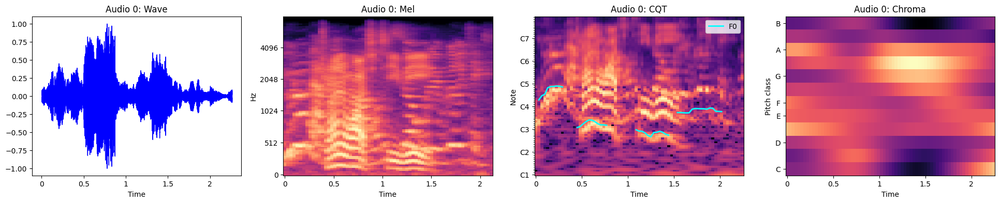

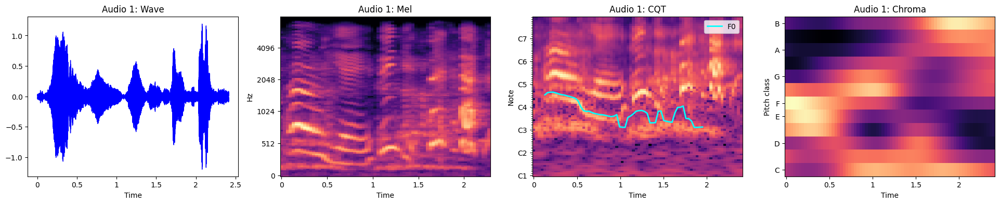

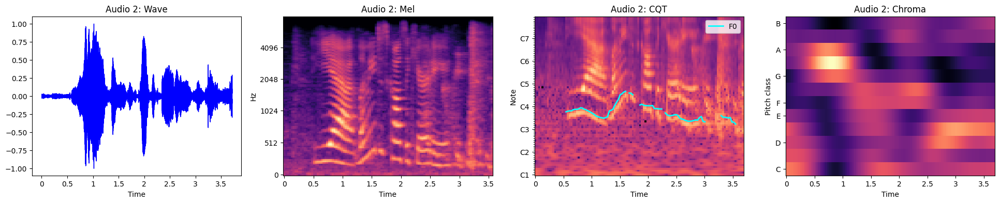

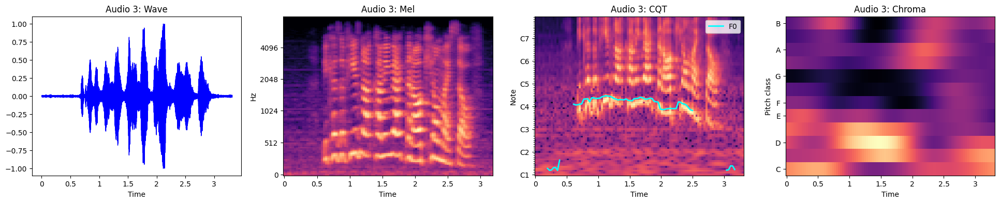

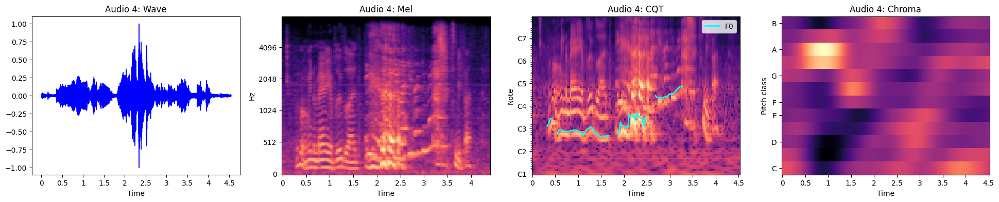

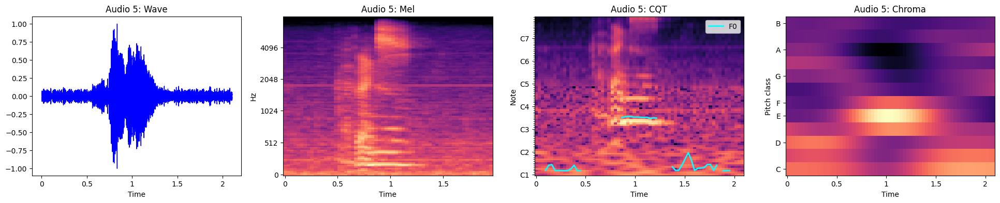

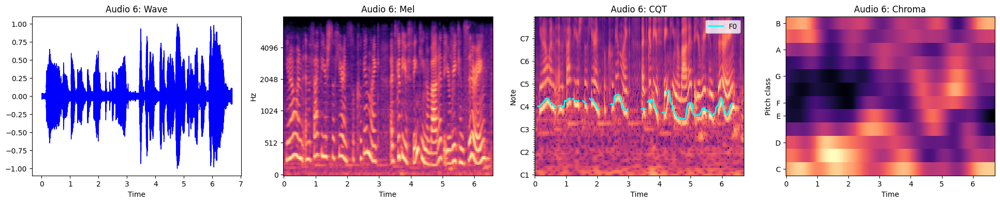

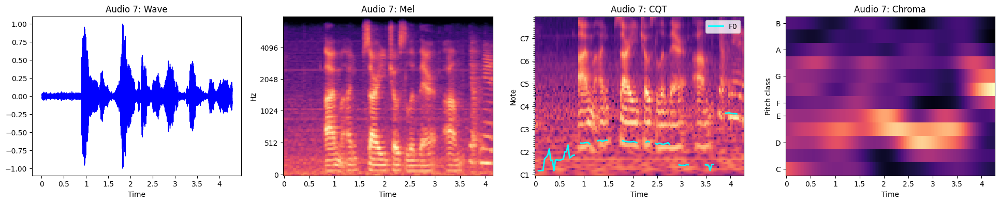

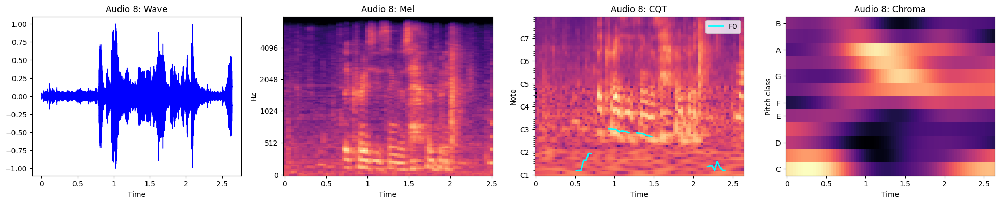

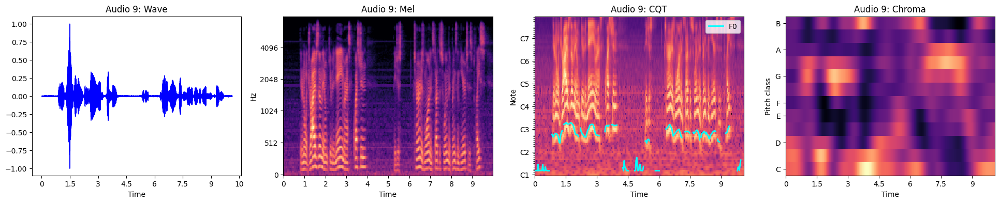

In [328]:
players = display_audio_list(d2_iemocap['x'].values)
for p in players:
    ipd.display(p)

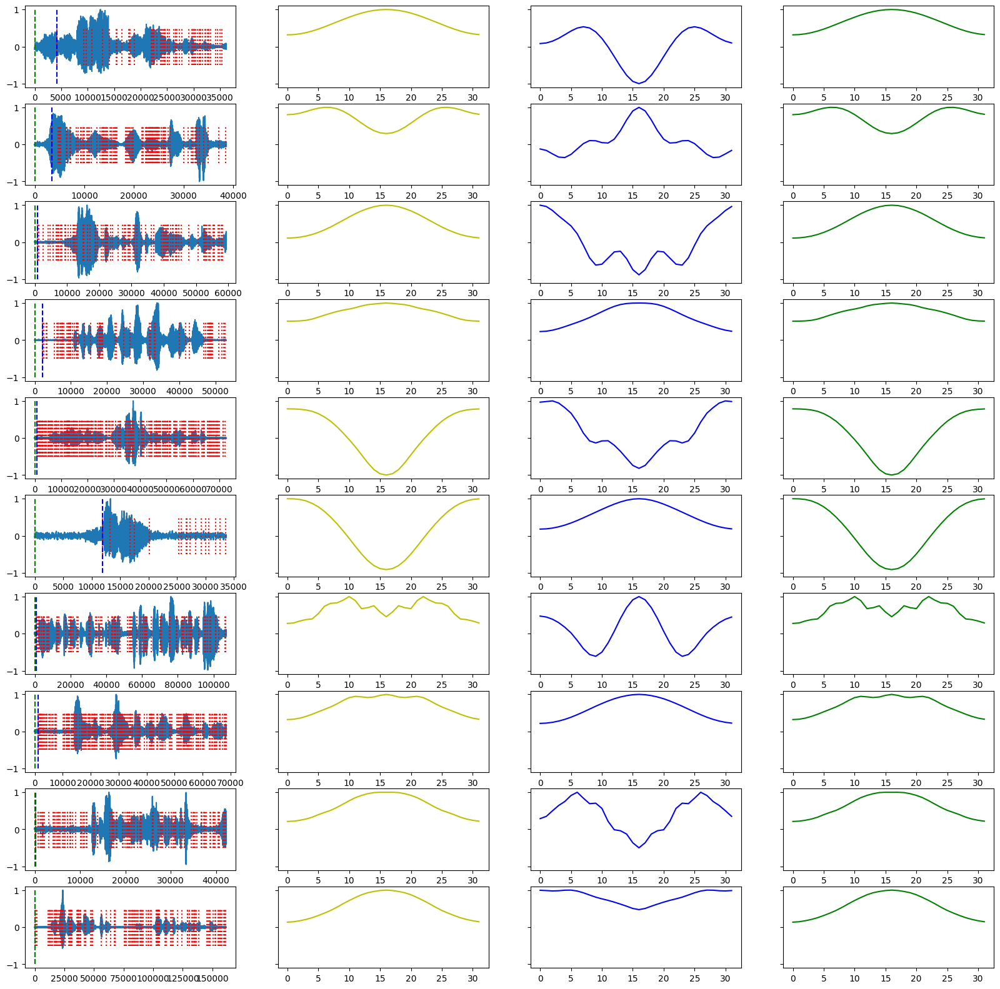

In [329]:
n = len(d2_iemocap)
segment_win_size, segment_stride = 32, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_iemocap['mi2'] = d2_iemocap.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_iemocap.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

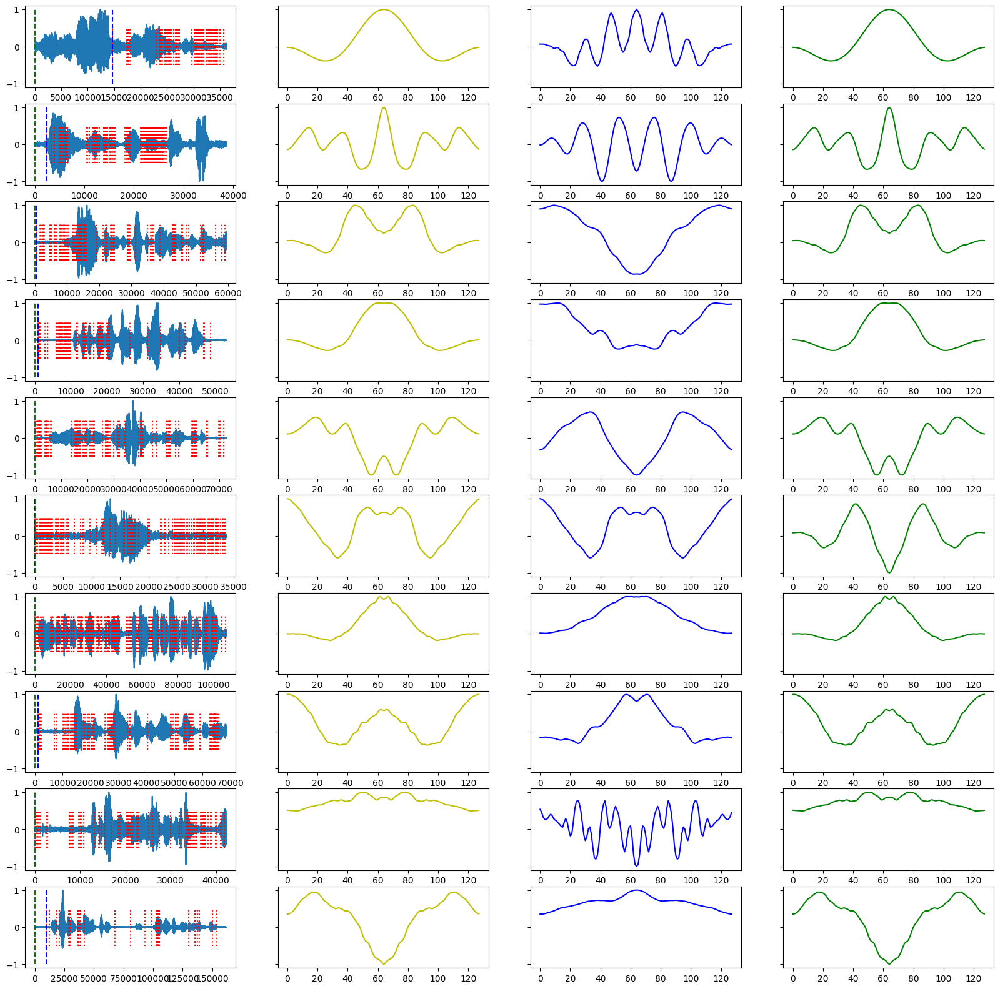

In [330]:
n = len(d2_iemocap)
segment_win_size, segment_stride = 128, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_iemocap['mi2'] = d2_iemocap.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_iemocap.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

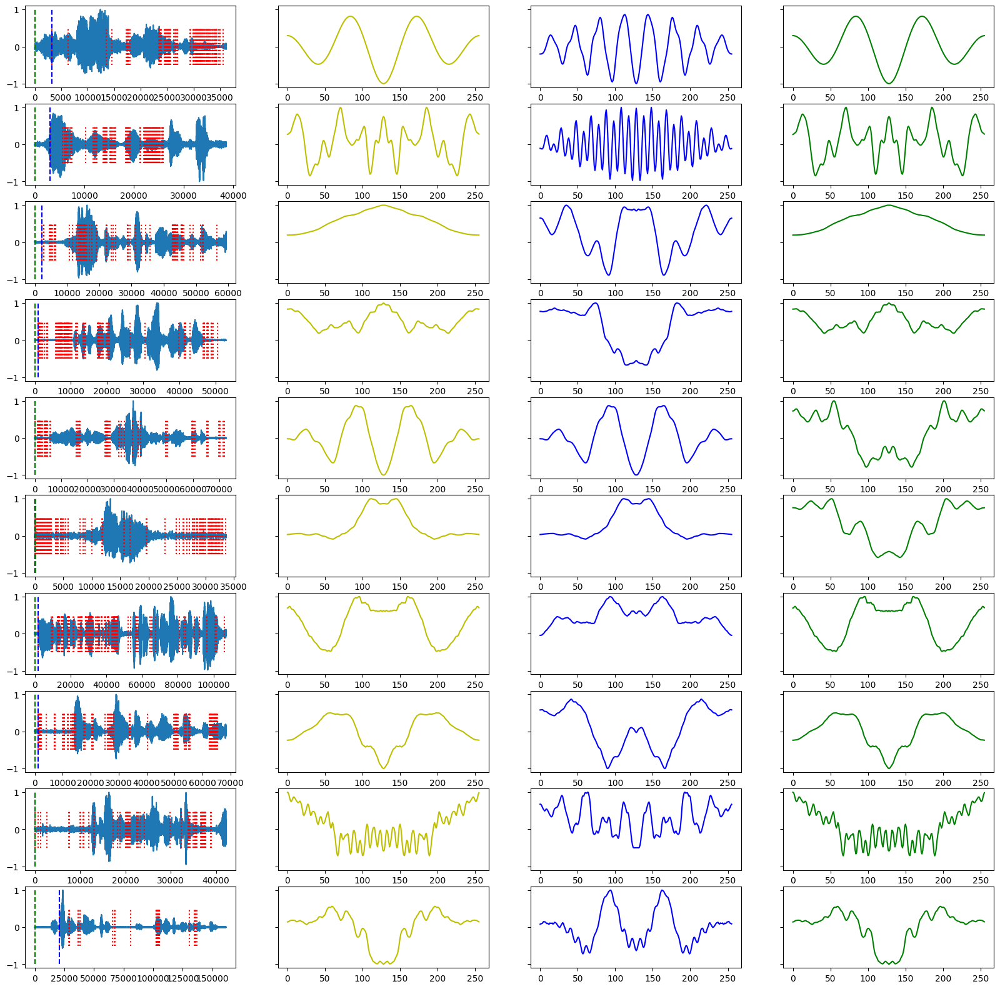

In [331]:
n = len(d2_iemocap)
segment_win_size, segment_stride = 256, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_iemocap['mi2'] = d2_iemocap.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_iemocap.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

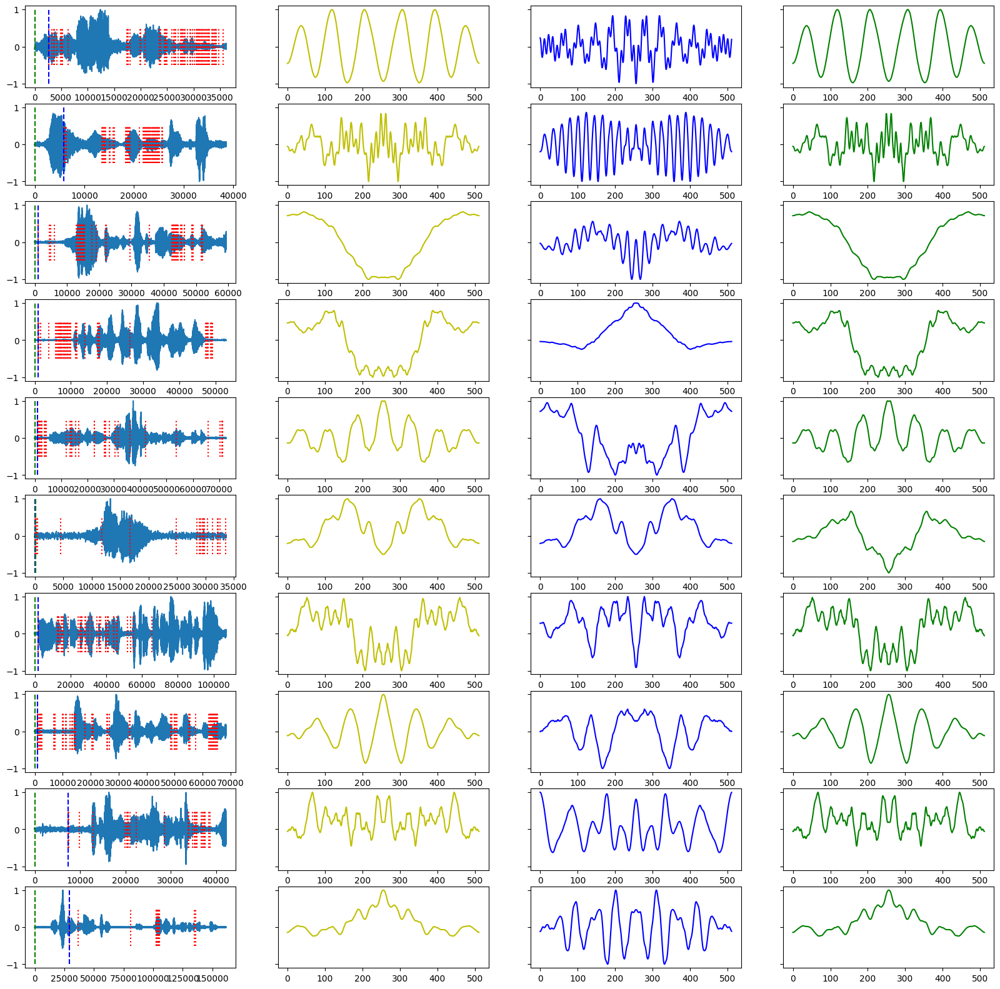

In [332]:
n = len(d2_iemocap)
segment_win_size, segment_stride = 512, 128
kernel_size, stride, downsampling = 512, 250, 8
d2_iemocap['mi2'] = d2_iemocap.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_iemocap.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

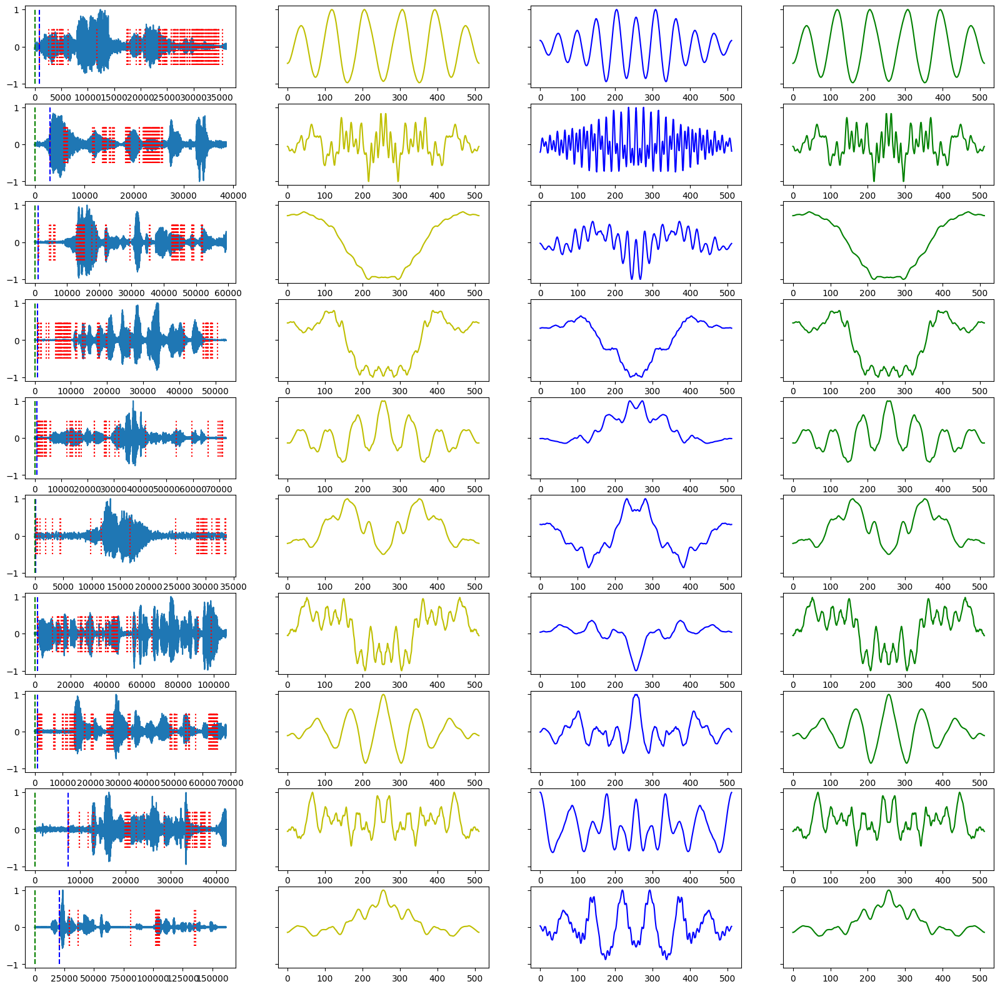

In [356]:
n = len(d2_iemocap)
segment_win_size, segment_stride = 512, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_iemocap['mi2'] = d2_iemocap.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_iemocap.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

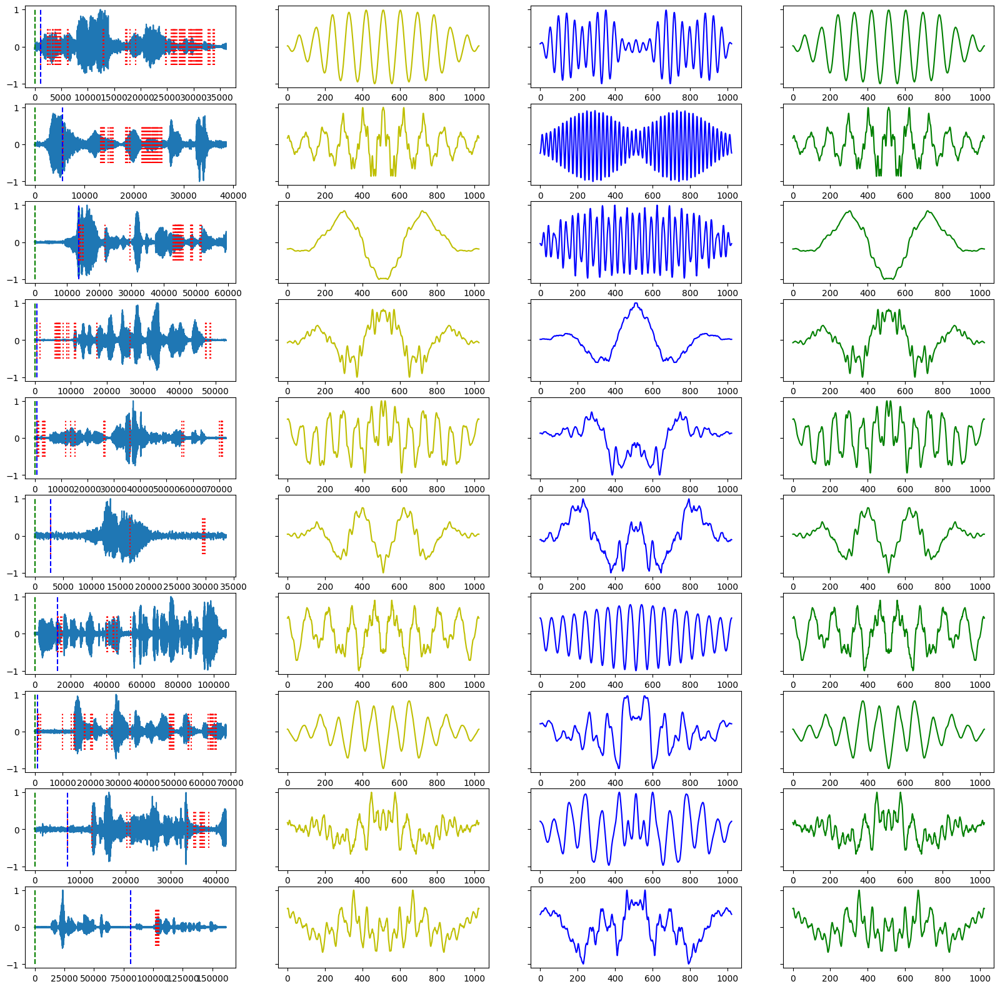

In [333]:
n = len(d2_iemocap)
segment_win_size, segment_stride = 1024, 128
kernel_size, stride, downsampling = 512, 250, 8
d2_iemocap['mi2'] = d2_iemocap.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_iemocap.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

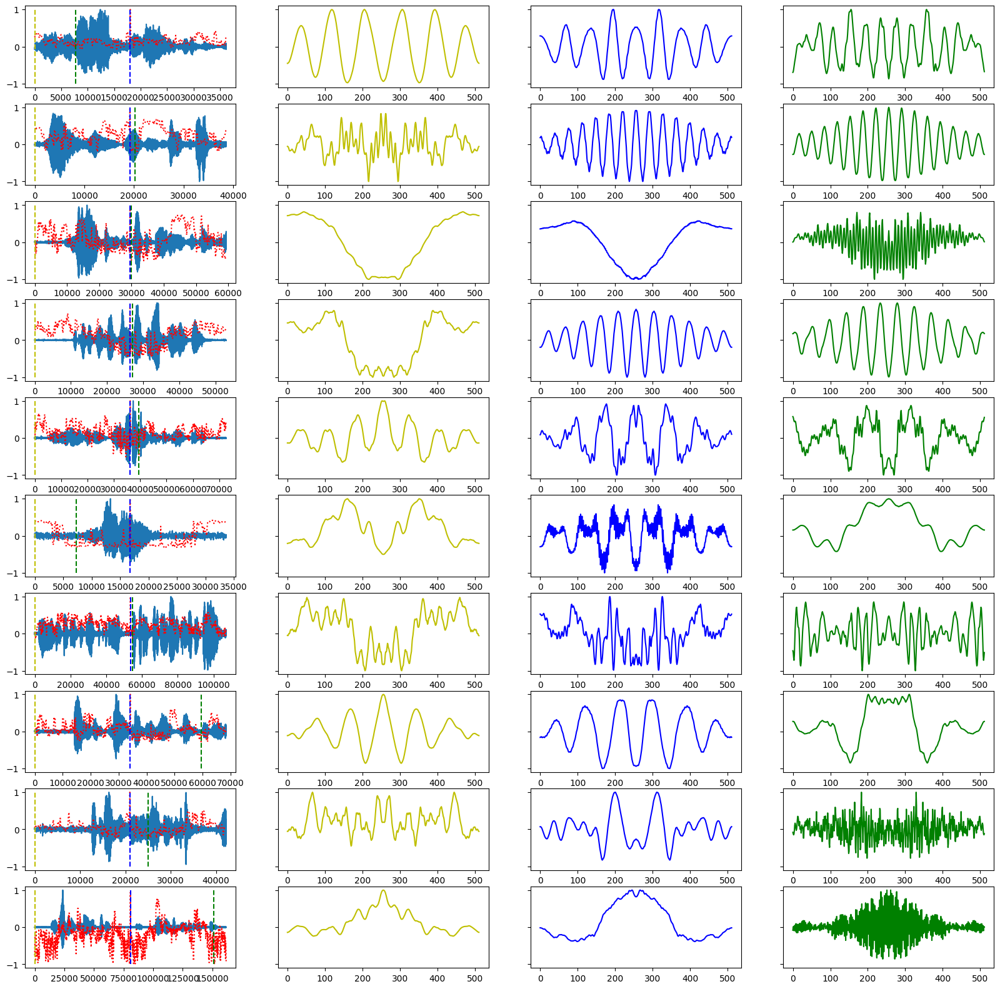

In [335]:
n = len(d2_iemocap)
segment_win_size, segment_stride = 512, 128
kernel_size, stride, downsampling = 512, 250, 8
d2_iemocap['mi'] = d2_iemocap.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_iemocap.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(np.abs(mi))
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'])*segment_stride, np.argmin(d['mi'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

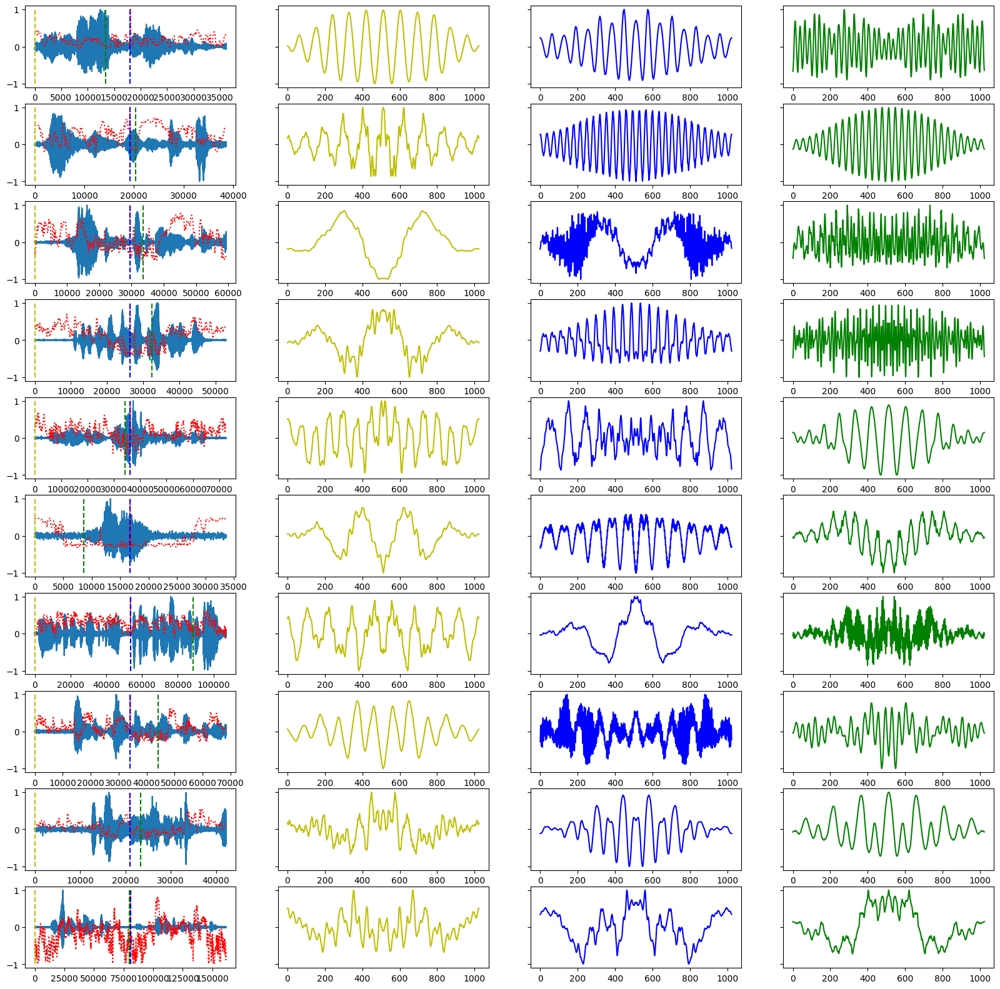

In [338]:
n = len(d2_iemocap)
segment_win_size, segment_stride = 1024, 128
kernel_size, stride, downsampling = 512, 250, 8
d2_iemocap['mi'] = d2_iemocap.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_iemocap.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(np.abs(mi))
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'][:-3])*segment_stride, np.argmin(d['mi'][:-3])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

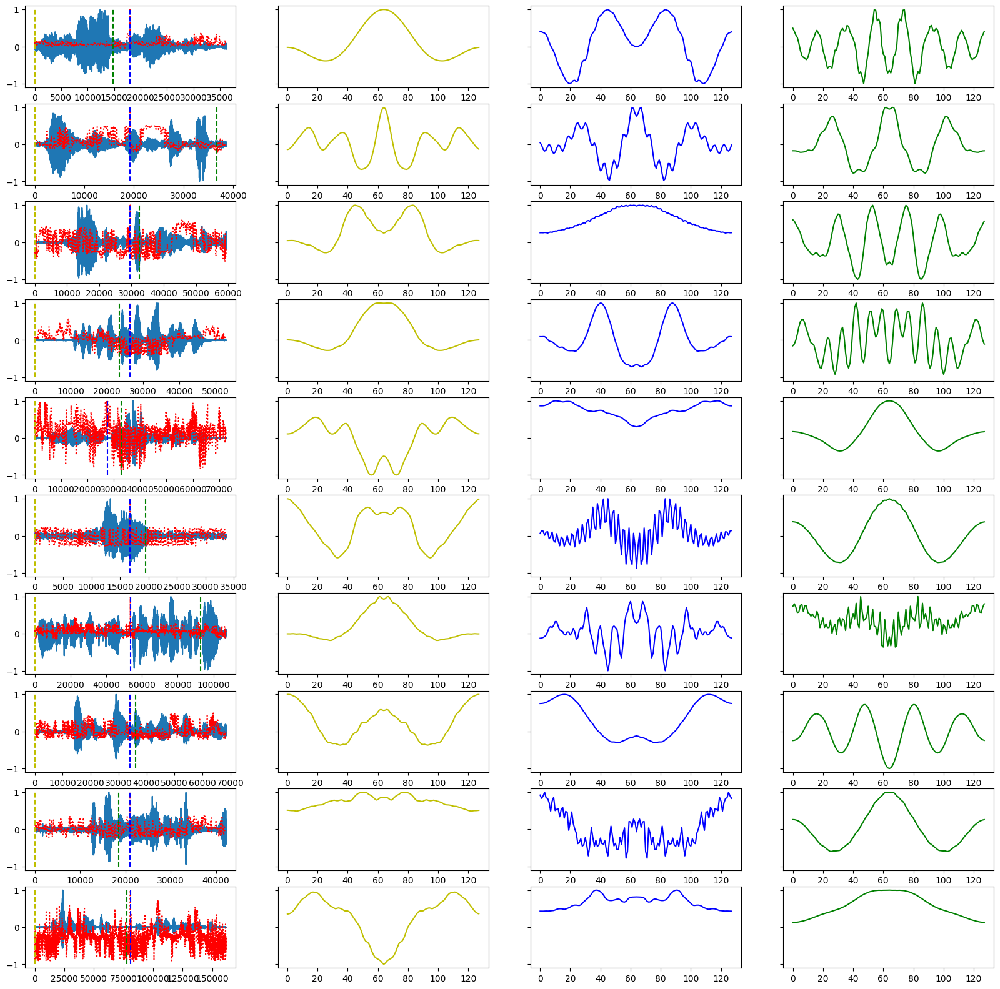

In [339]:
n = len(d2_iemocap)
segment_win_size, segment_stride = 128, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_iemocap['mi'] = d2_iemocap.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_iemocap.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(np.abs(mi))
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'][:-3])*segment_stride, np.argmin(d['mi'][:-3])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

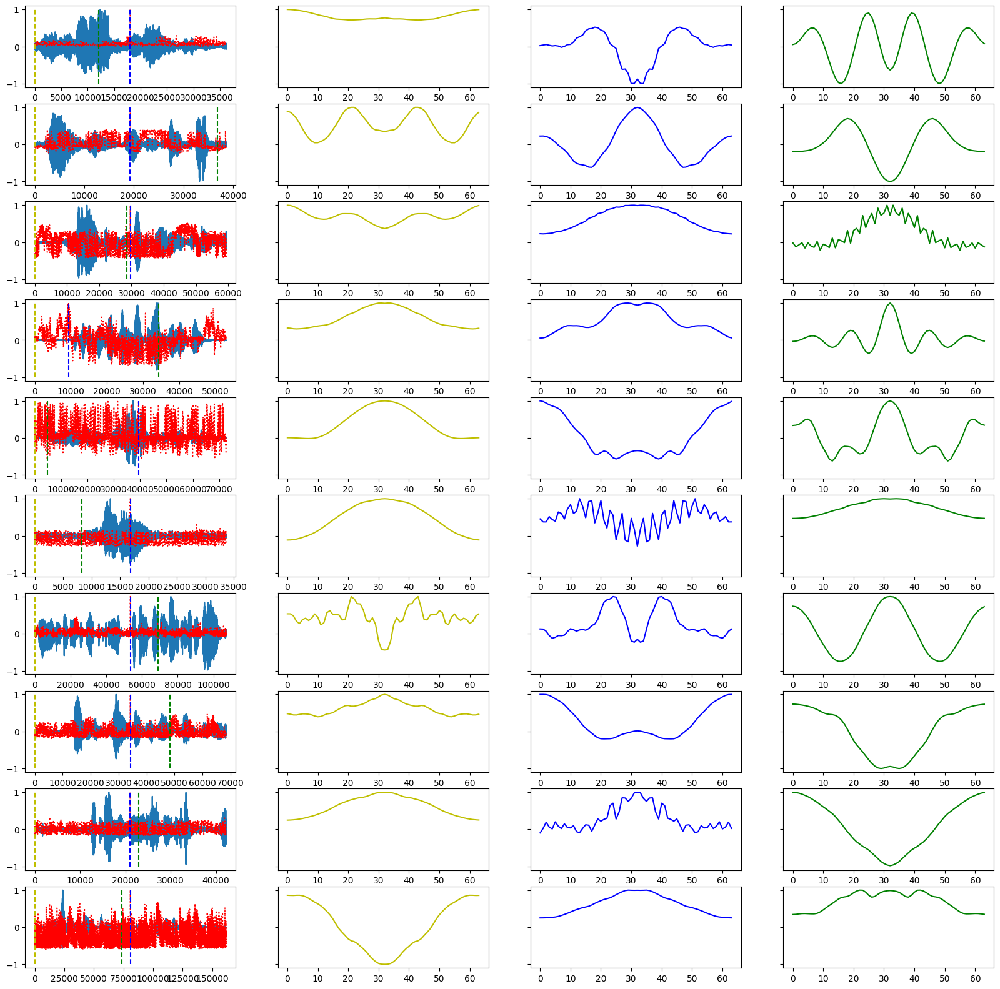

In [340]:
n = len(d2_iemocap)
segment_win_size, segment_stride = 64, 32
kernel_size, stride, downsampling = 512, 250, 8
d2_iemocap['mi'] = d2_iemocap.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_iemocap.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(np.abs(mi))
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'][:-3])*segment_stride, np.argmin(d['mi'][:-3])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

In [341]:
[labels[i] for i in y_test_meld[:20]]

['ang',
 'hap',
 'ang',
 'ang',
 'ang',
 'ang',
 'ang',
 'hap',
 'ang',
 'ang',
 'neu',
 'hap',
 'ang',
 'ang',
 'ang',
 'sad',
 'hap',
 'sad',
 'ang',
 'sad']

In [342]:
d2_meld = pd.DataFrame({'x': x_test_meld[10:20], 'y': y_test_meld[10:20]})

Audio 0
Audio 1
Audio 2
Audio 3
Audio 4
Audio 5
Audio 6
Audio 7
Audio 8
Audio 9


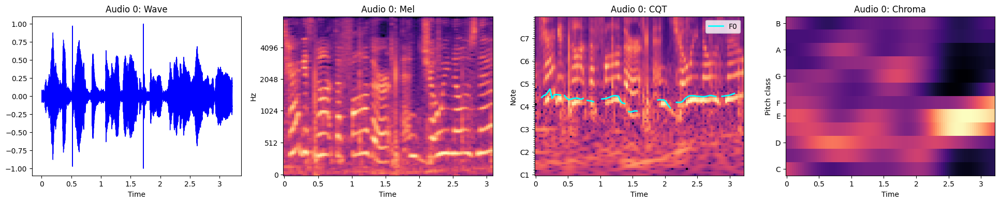

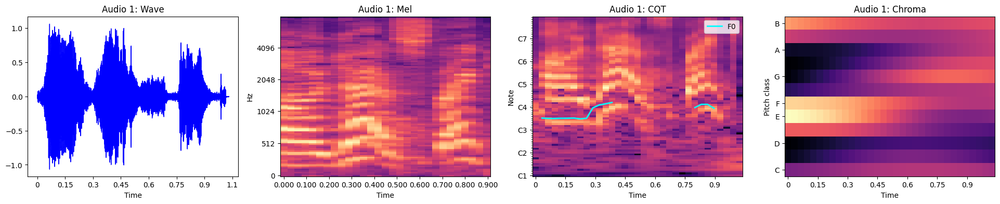

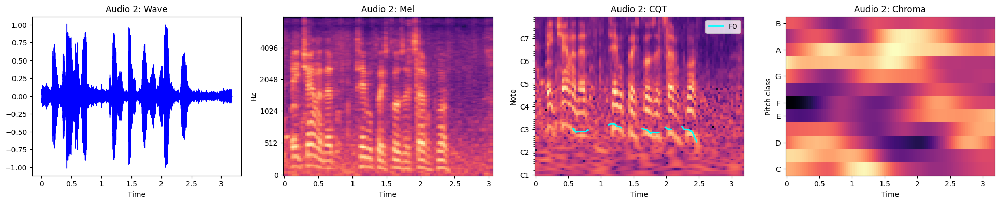

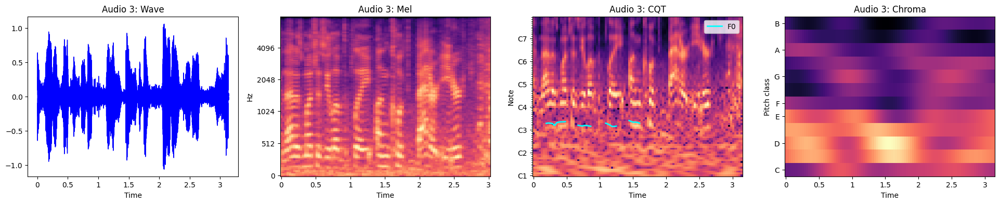

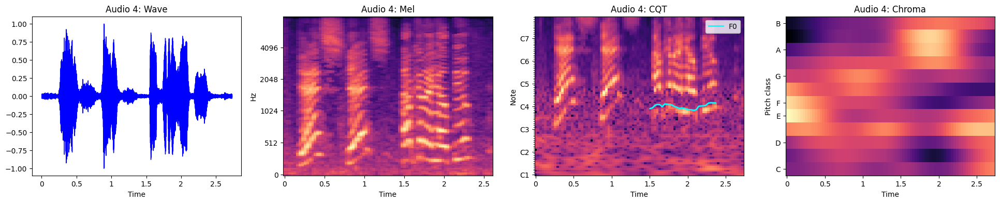

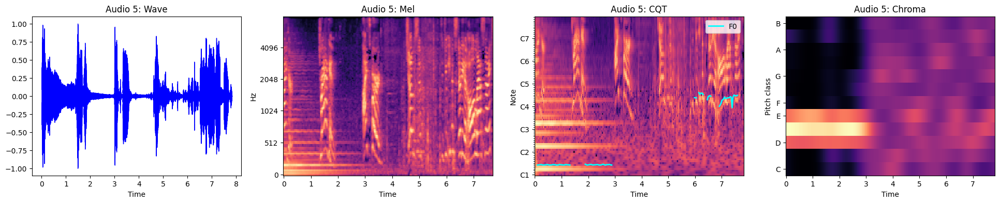

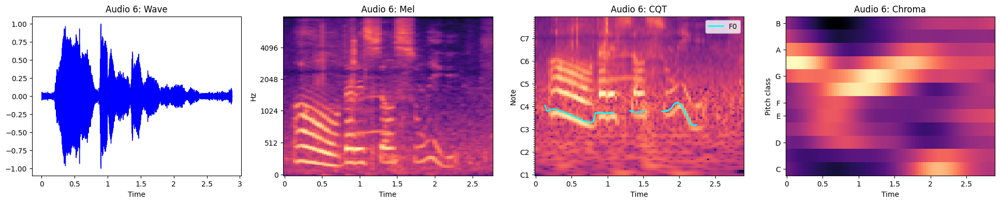

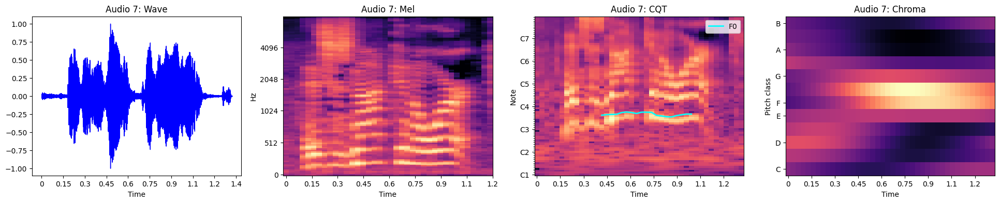

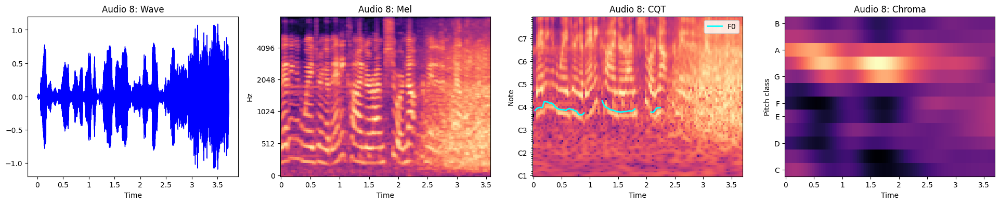

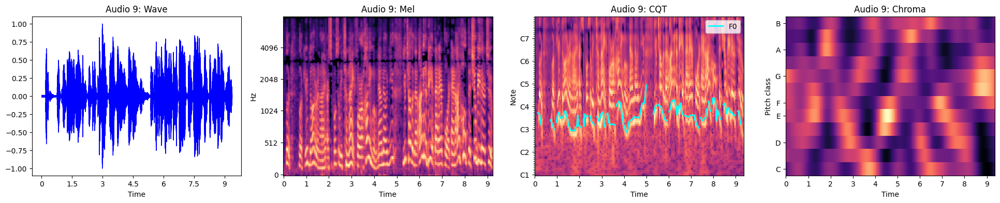

In [355]:
players = display_audio_list(d2_meld['x'].values)
for p in players:
    ipd.display(p)

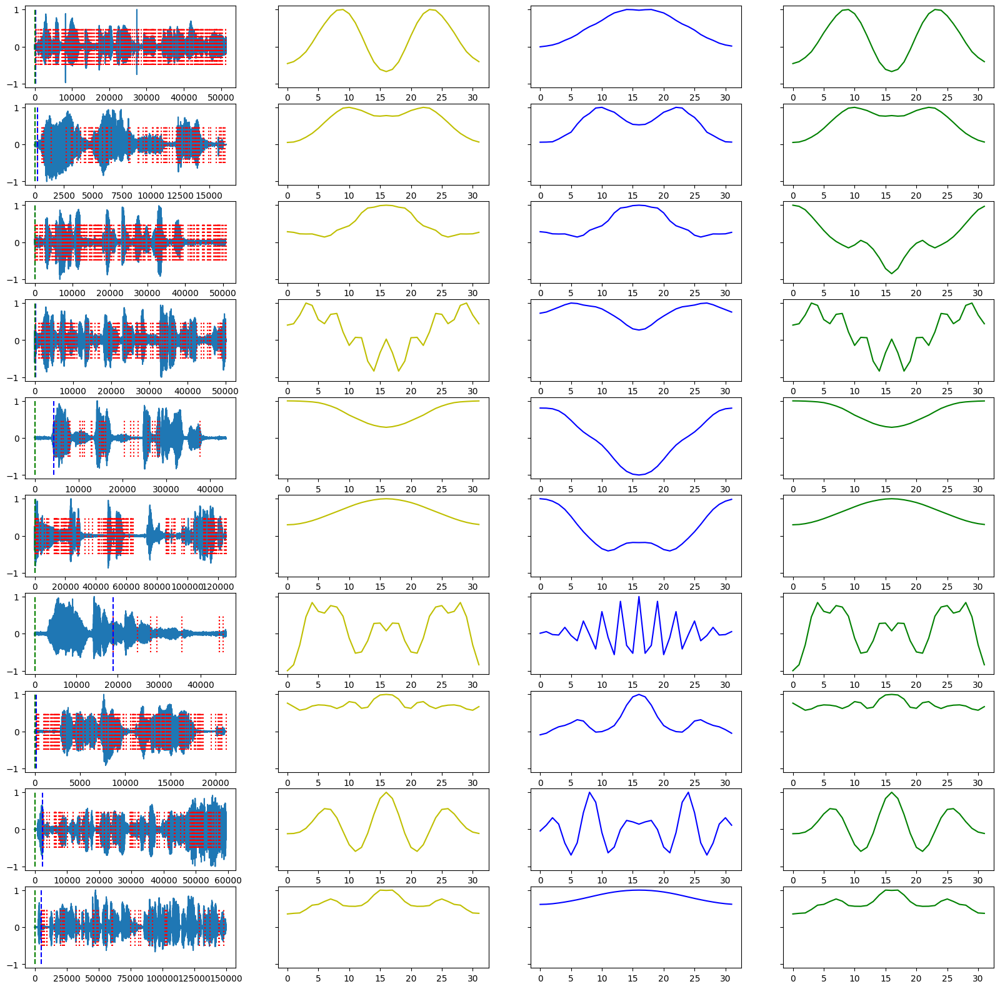

In [343]:
n = len(d2_meld)
segment_win_size, segment_stride = 32, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi2'] = d2_meld.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

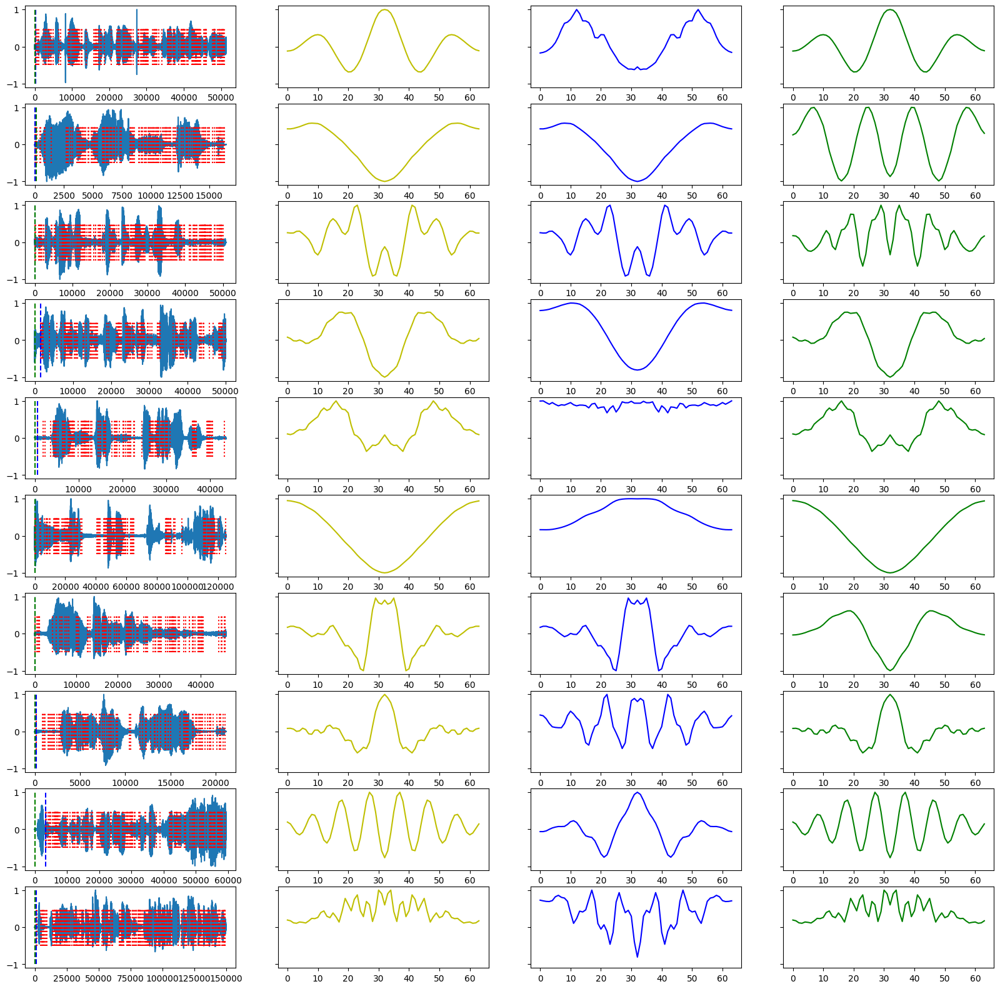

In [344]:
n = len(d2_meld)
segment_win_size, segment_stride = 64, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi2'] = d2_meld.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

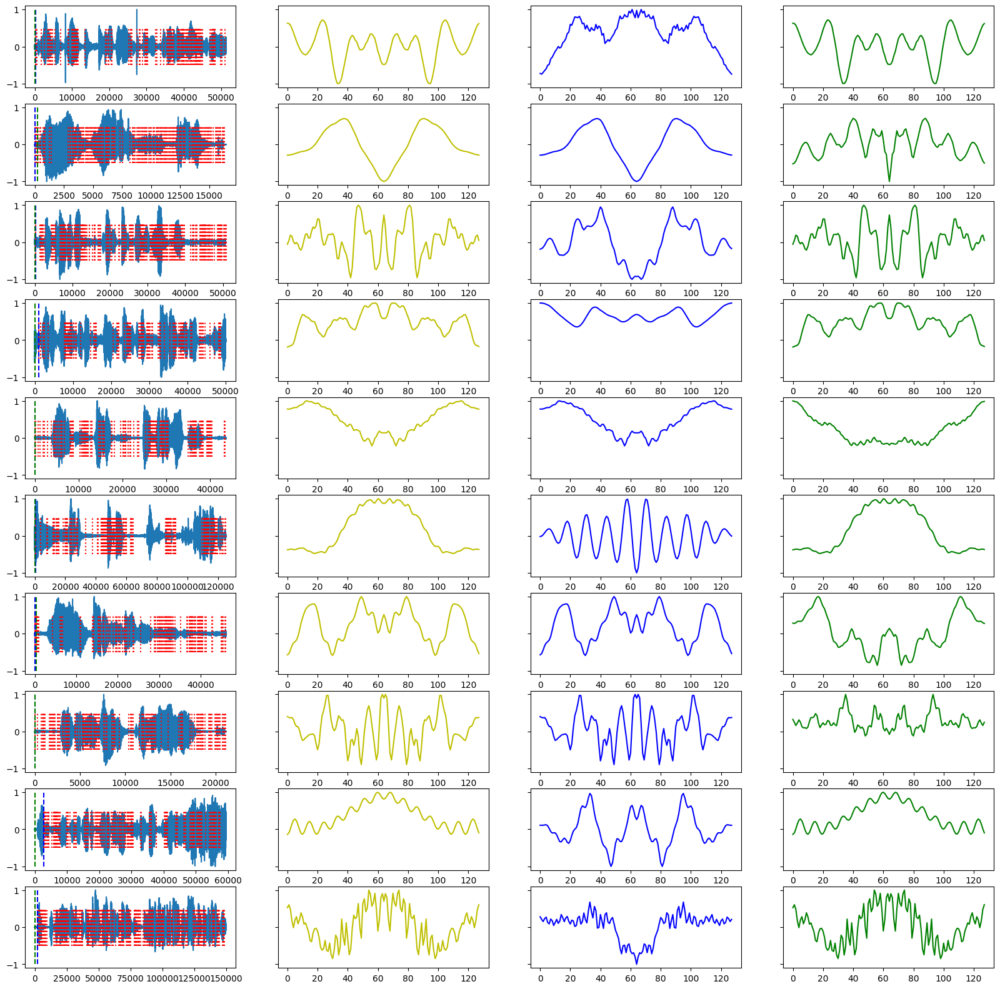

In [345]:
n = len(d2_meld)
segment_win_size, segment_stride = 128, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi2'] = d2_meld.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

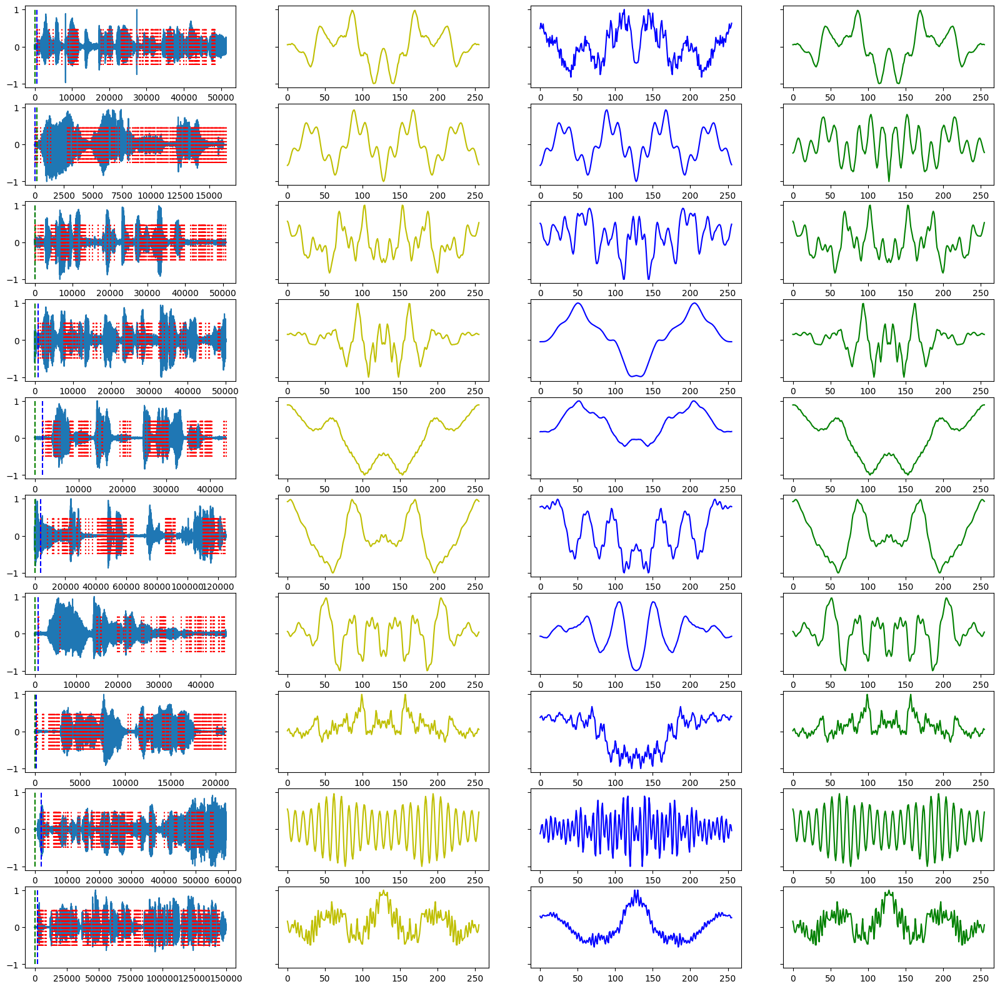

In [346]:
n = len(d2_meld)
segment_win_size, segment_stride = 256, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi2'] = d2_meld.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

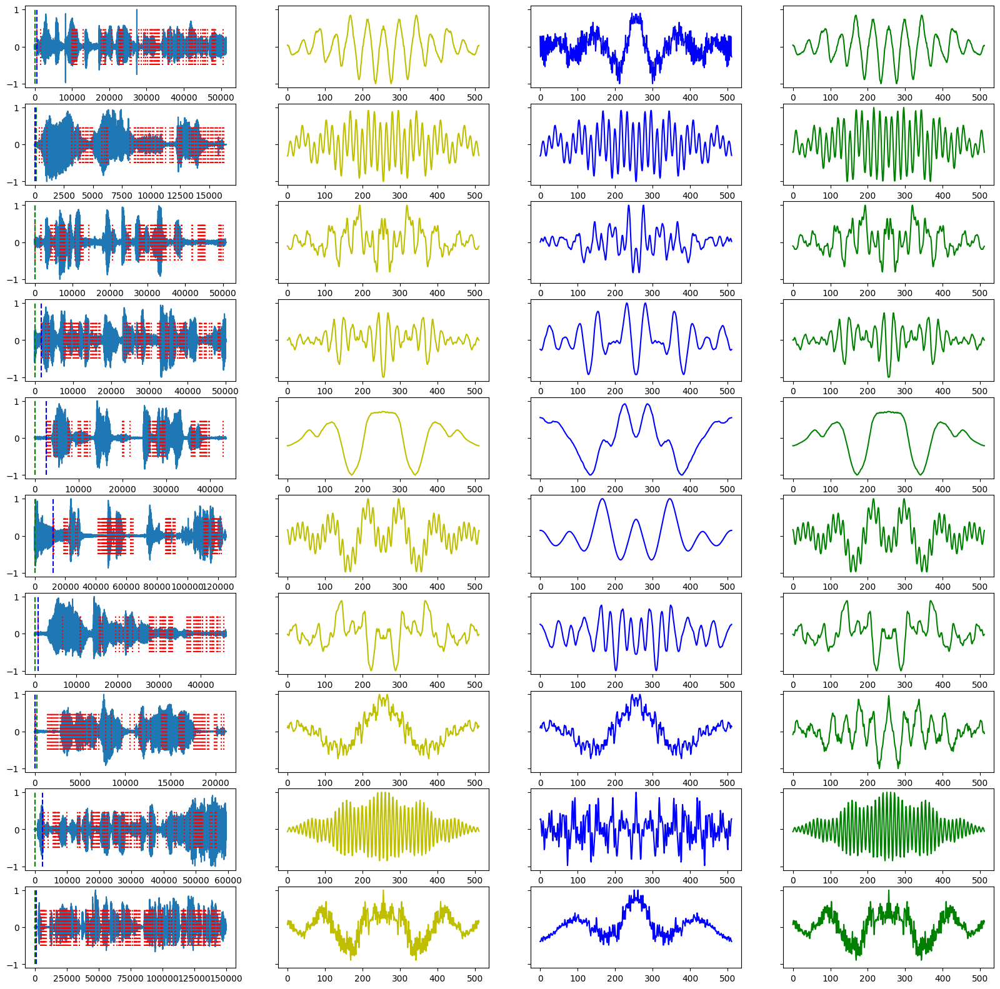

In [347]:
n = len(d2_meld)
segment_win_size, segment_stride = 512, 128
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi2'] = d2_meld.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

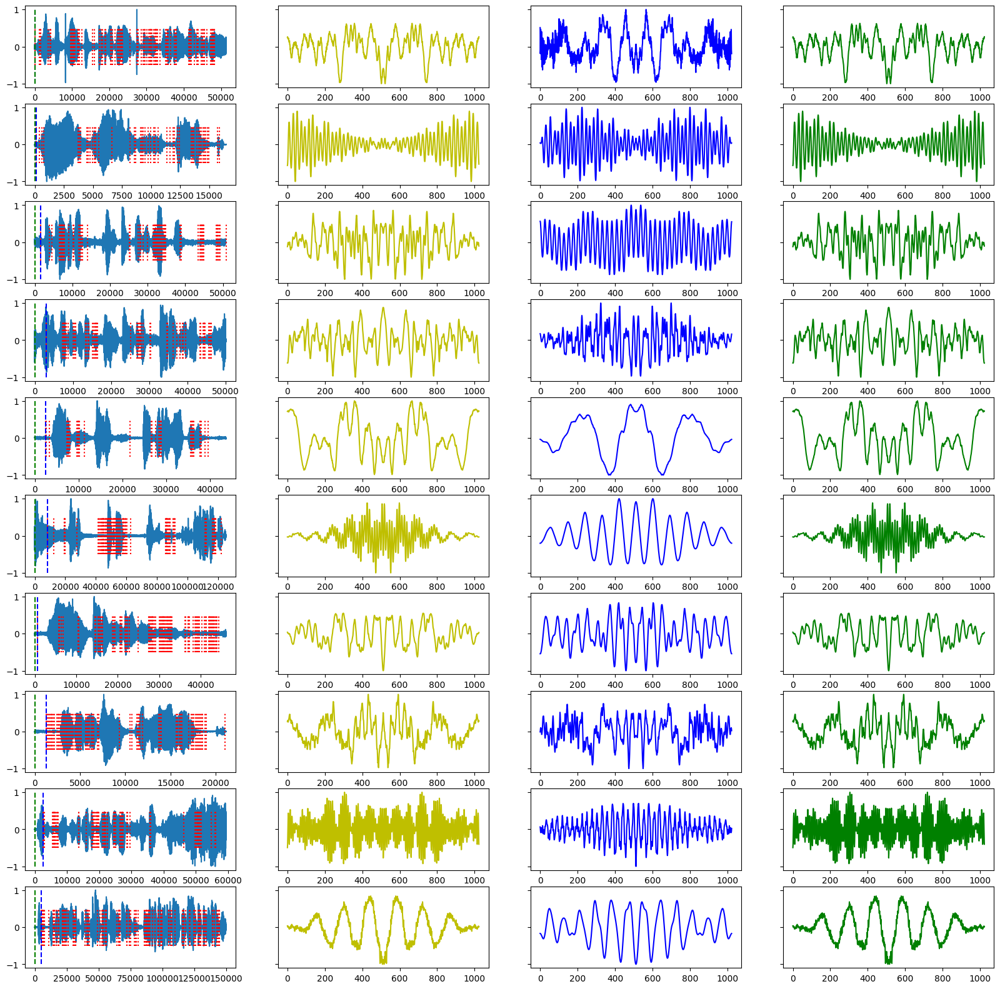

In [348]:
n = len(d2_meld)
segment_win_size, segment_stride = 1024, 128
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi2'] = d2_meld.apply(lambda x: mutual_info_check2(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi2']))*segment_stride
    mi = d['mi2']
    for j, m in enumerate(mi):
        if m == 1:
            axes[i, 0].vlines(mi_x[j], ymax=0.5, ymin=-0.5, color='r', linestyle='dotted')

    positions = [0, np.argmax(d['mi2'])*segment_stride, np.argmin(d['mi2'])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

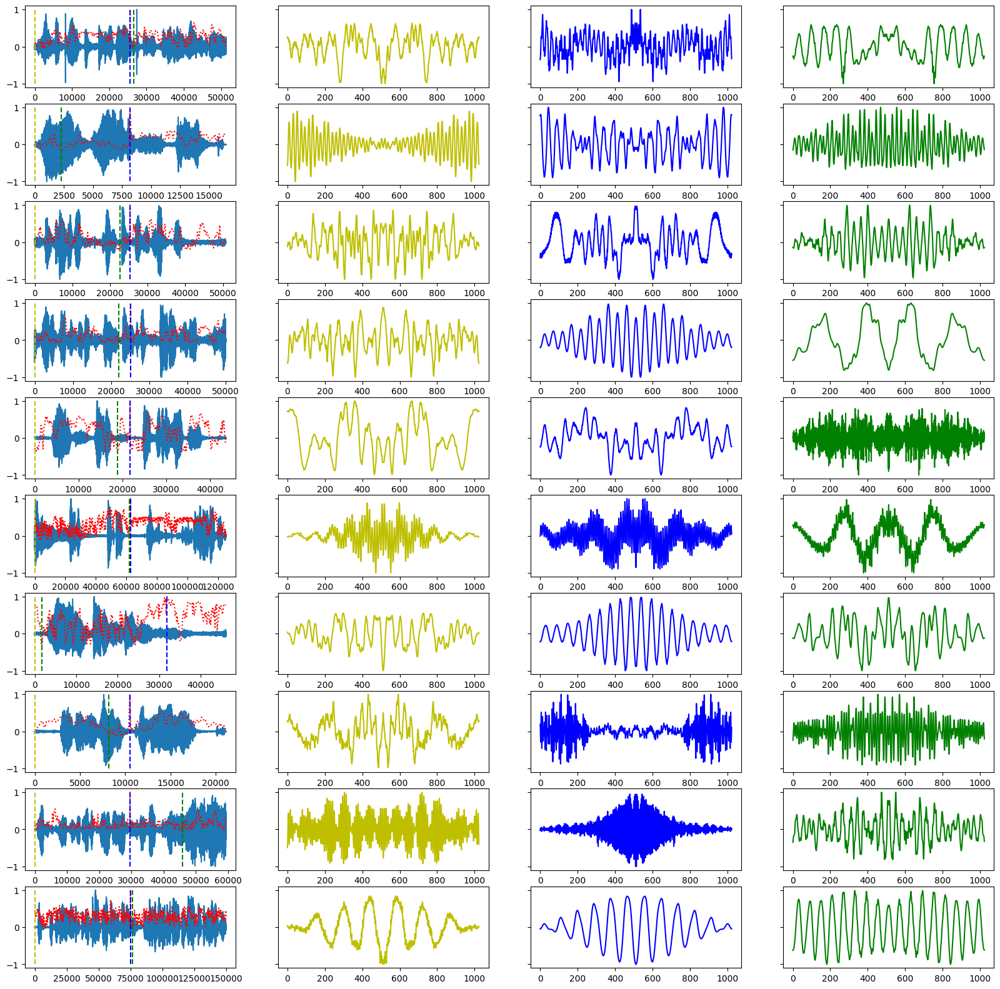

In [349]:
n = len(d2_meld)
segment_win_size, segment_stride = 1024, 128
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi'] = d2_meld.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(np.abs(mi))
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'][:-3])*segment_stride, np.argmin(d['mi'][:-3])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

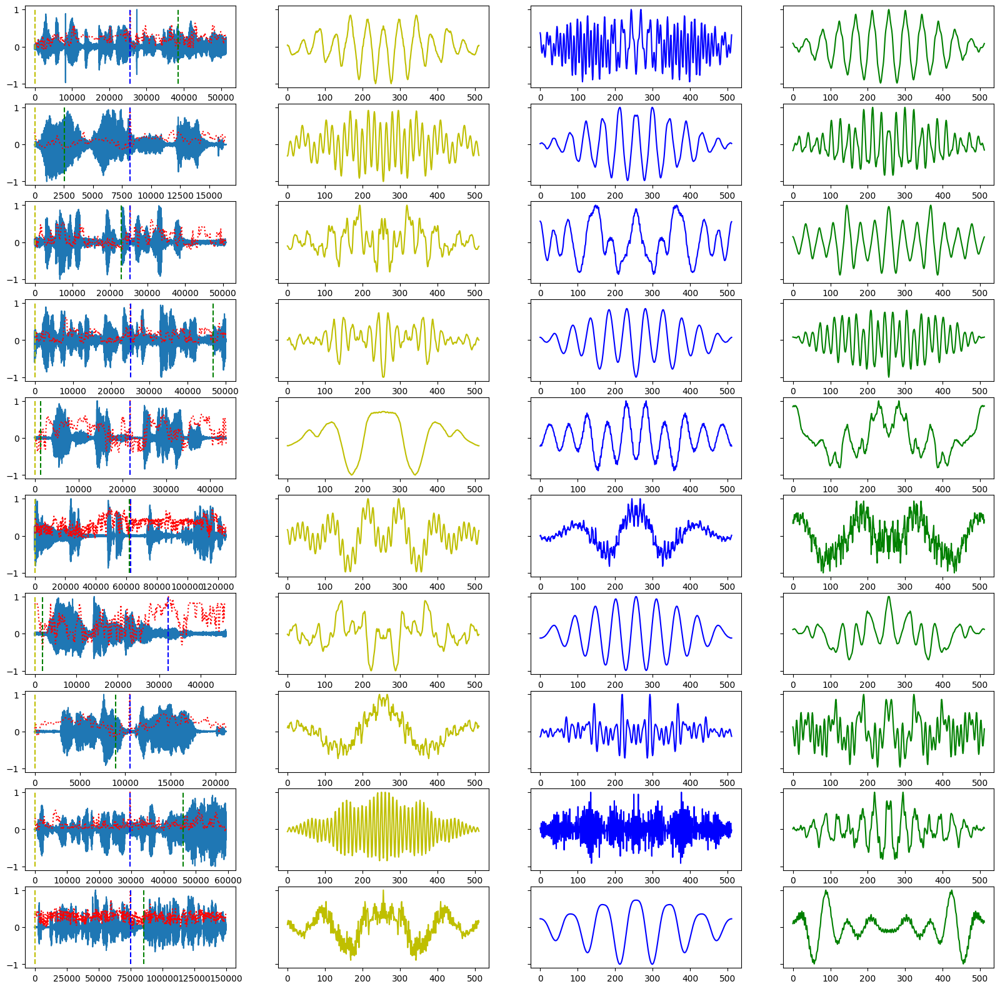

In [350]:
n = len(d2_meld)
segment_win_size, segment_stride = 512, 128
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi'] = d2_meld.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(np.abs(mi))
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'][:-3])*segment_stride, np.argmin(d['mi'][:-3])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

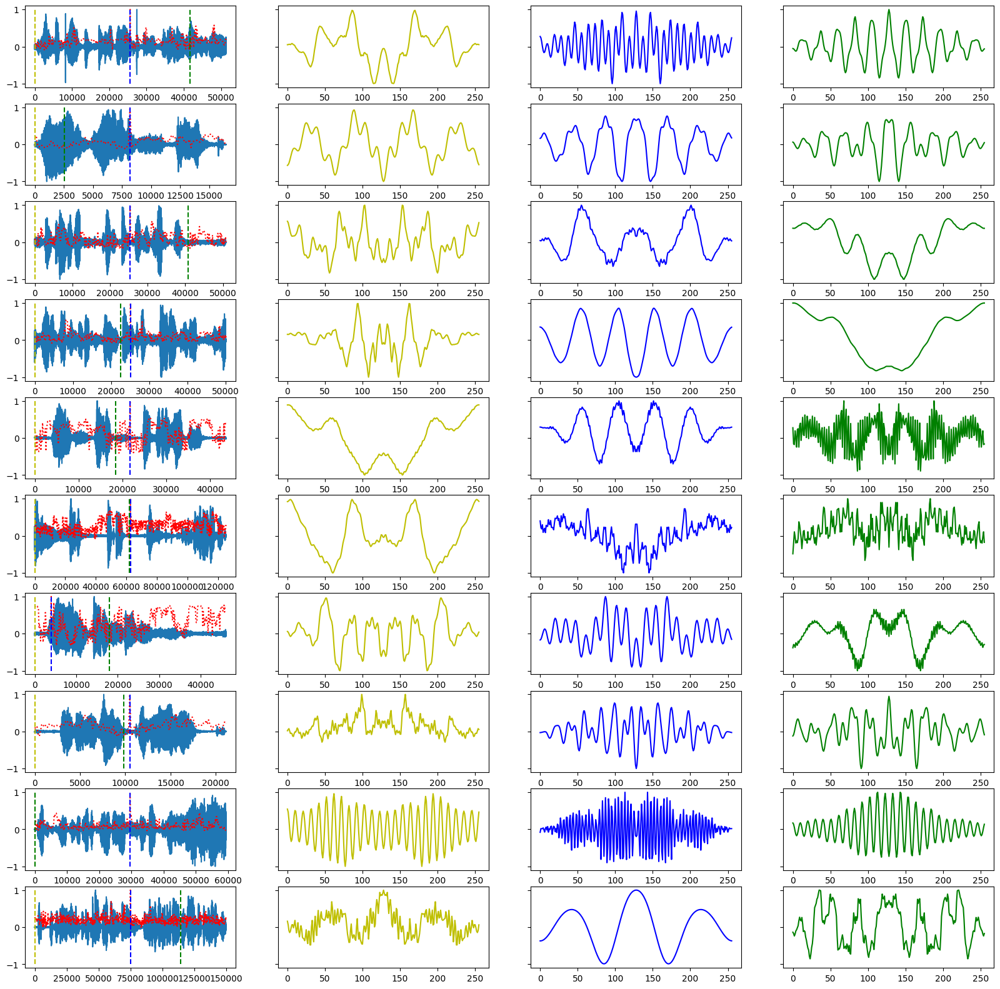

In [351]:
n = len(d2_meld)
segment_win_size, segment_stride = 256, 128
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi'] = d2_meld.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(np.abs(mi))
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'][:-3])*segment_stride, np.argmin(d['mi'][:-3])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

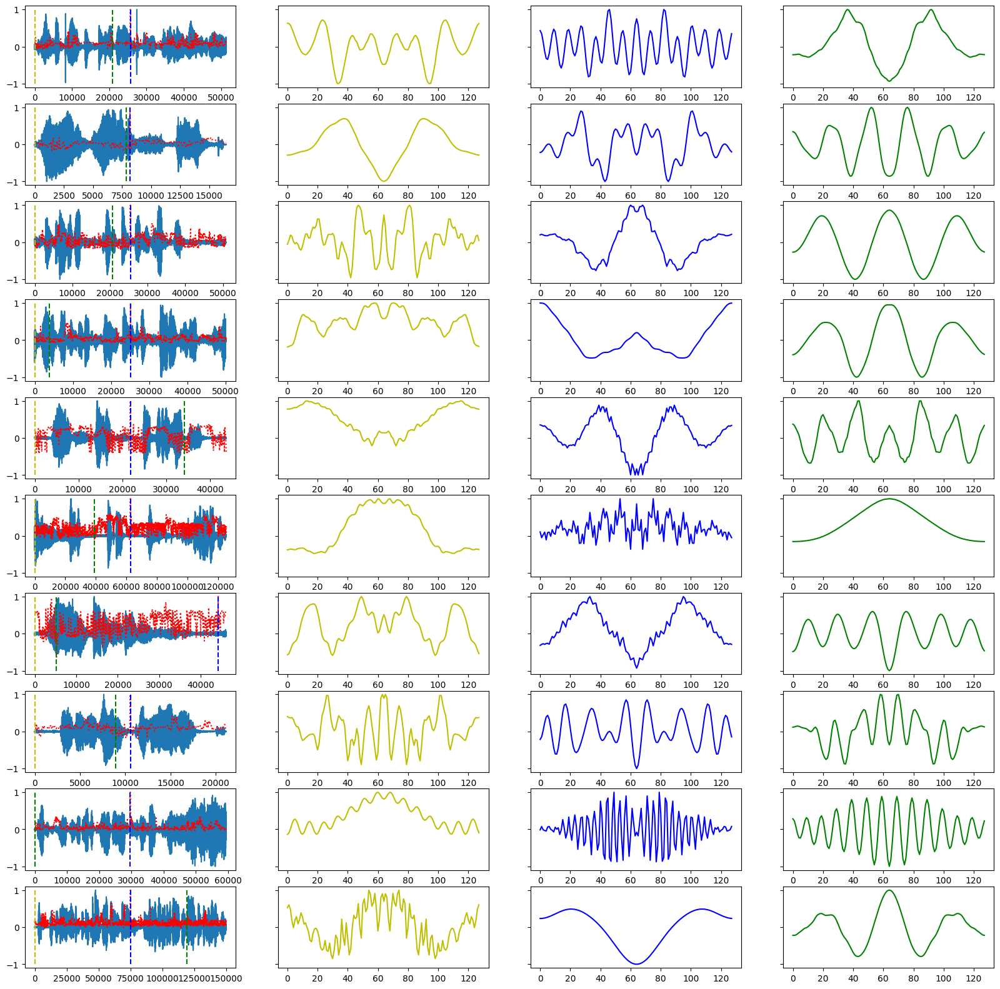

In [352]:
n = len(d2_meld)
segment_win_size, segment_stride = 128, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi'] = d2_meld.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(np.abs(mi))
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'][:-3])*segment_stride, np.argmin(d['mi'][:-3])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

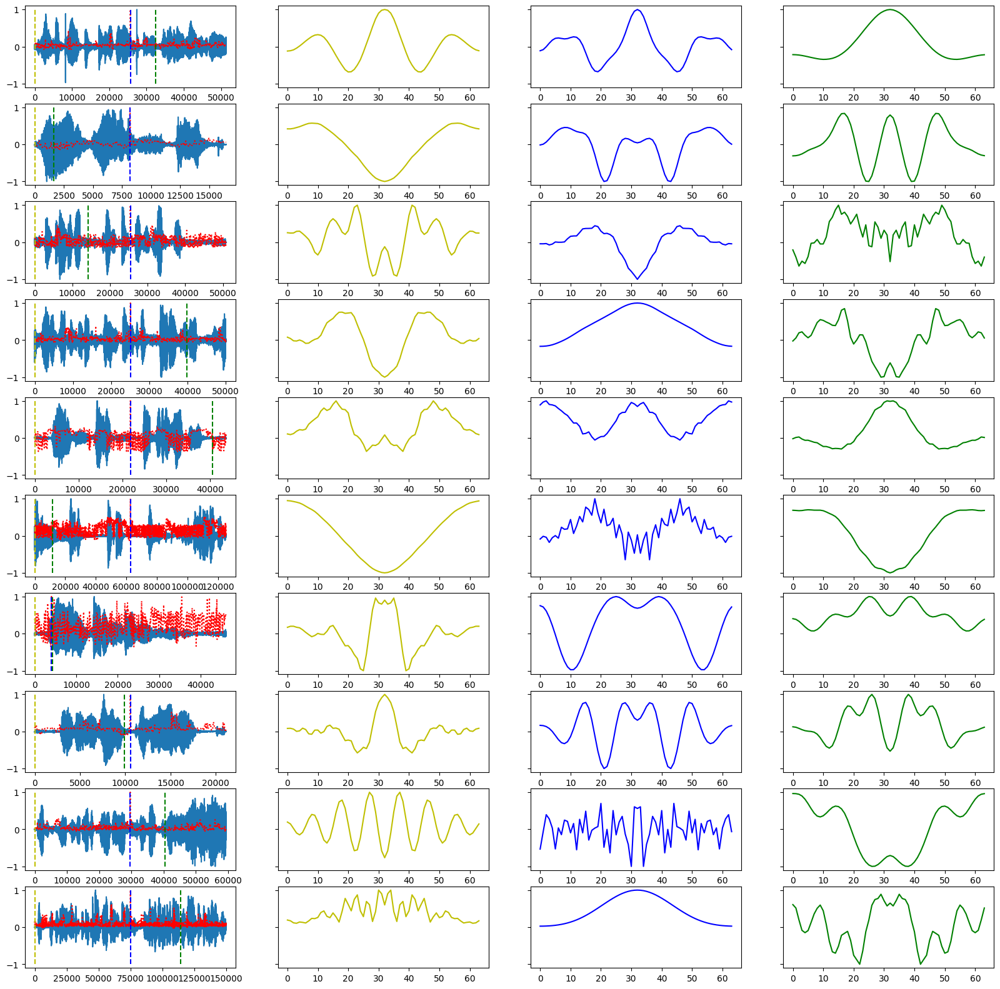

In [353]:
n = len(d2_meld)
segment_win_size, segment_stride = 64, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi'] = d2_meld.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(np.abs(mi))
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'][:-3])*segment_stride, np.argmin(d['mi'][:-3])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

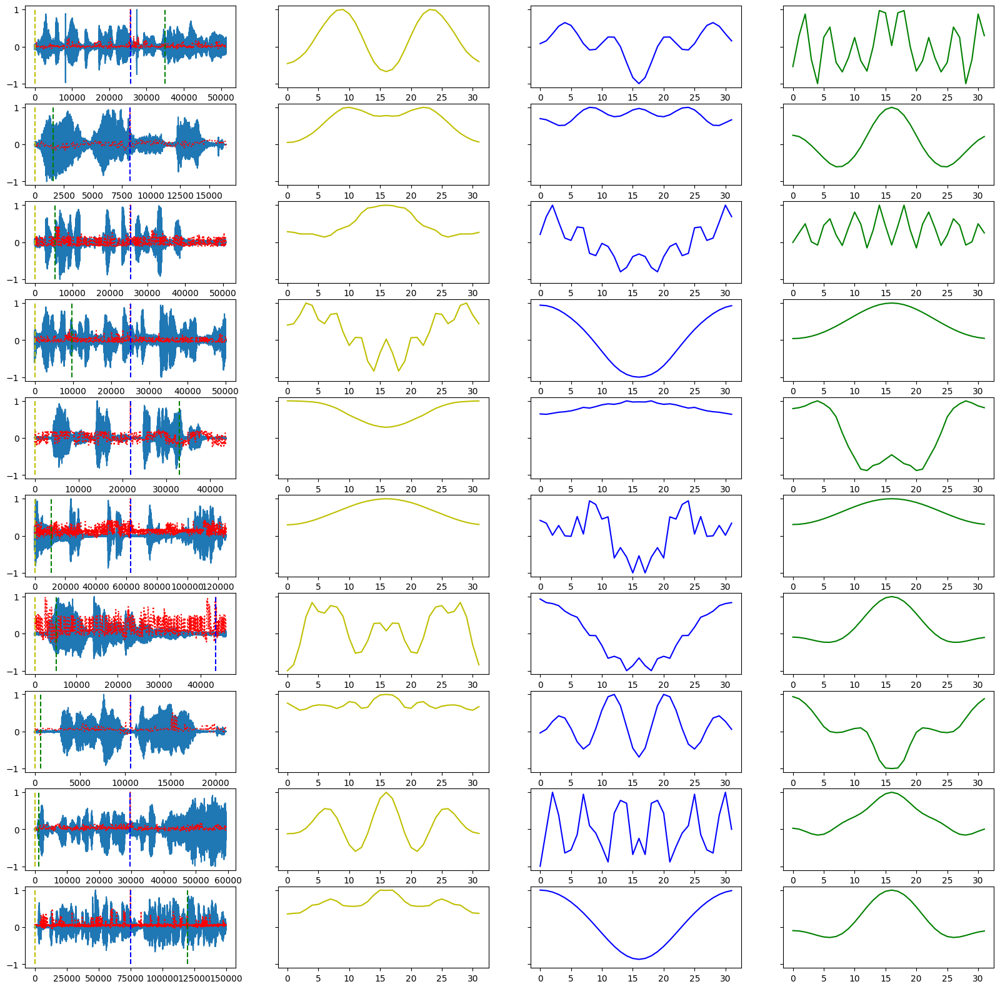

In [354]:
n = len(d2_meld)
segment_win_size, segment_stride = 32, 64
kernel_size, stride, downsampling = 512, 250, 8
d2_meld['mi'] = d2_meld.apply(lambda x: mutual_info_check(
    x['x'], segment_win_size=segment_win_size, segment_stride=segment_stride,
    kernel_size=kernel_size, stride=stride, downsampling=downsampling, threshold=0.), axis=1)
fig, axes = plt.subplots(n, 4, figsize=(20, n*2), sharey=True)
for i in range(n):
    d = d2_meld.iloc[i]
    norm_fn = lambda A: A / torch.clamp(A.abs().amax(dim=-1, keepdim=True), min=torch.finfo(A.dtype).eps)
    
    axes[i, 0].plot(norm_fn(torch.tensor(d['x'])))
    mi_x = np.arange(len(d['mi']))*segment_stride
    mi = [v/100 for v in d['mi']]
    mi_max = max(np.abs(mi))
    mi = [v / mi_max for v in mi]
    axes[i, 0].plot(mi_x, mi, color='red', linestyle='dotted')

    positions = [0, np.argmax(d['mi'][:-3])*segment_stride, np.argmin(d['mi'][:-3])*segment_stride]
    colors = ['y', 'b', 'g']

    for j, p in enumerate(positions):
        axes[i, j+1].plot(acov_compute(d['x'], position=p, kernel_size=segment_win_size), color=colors[j])
        axes[i, 0].vlines(p, ymax=1., ymin=-1., color=colors[j], linestyle='dashed')

In [109]:
d1.apply(lambda x: print(mutual_info_mask(x['x'])), axis=1)

[9, 45, 4, 4, 12, 49, 8, 7, 16, 17, -2, 19, -2, 3, -13, -8, -1, -21, -4, -5, 2, 10, -4, 2, 9, 189, 189, 4, 16, -4, 9, 189, 189, 189, 189, 0, 10, -9, 20, 0, -3, 7, 25, 13, 15, 8, 30, 9, 52, 0, 36, 12]
[22, 10, 49, 13, 14, 16, 44, 19, 11, 12, 4, -1, 8, -12, -7, 1, -20, -1, 1, 23, 193, 2, 1, -6, 6, 2, 193, 2, 14, 3, -13, 11, -15, -1, -16, -8, 6, -11, 0, -13, 10, -8, -1, 16, 40, 27, 32, 14, 12, 48, 55, 36, 41]
[-7, 38, -2, 1, 28, -5, -10, -5, -2, -2, -3, -5, -3, -10, 15, 1, -15, -7, 4, 5, 179, -6, 7, 179, -21, 179, -14, -19, -25, 2, -10, 0, -13, -9, 4, -8, 0, -4, -24, -4, 12, 4, 38, 55, 21, 12, -5, -1, 59, -8, 20, 12]
[2, 13, 4, -3, -5, 11, -7, -17, -12, 2, -7, 11, -12, 2, -10, -13, -6, -8, -16, -19, -36, -10, -41, -46, 176, -20, -14, -41, -28, -10, 1, -15, 16, 176, -5, -24, -9, -2, -1, -1, -8, 77, 81, 16, 0, 8, -15, -7, 0, 5]
[4, 30, 71, 82, 29, 39, -7, 30, 20, 6, 3, -10, -12, 24, -1, 8, 8, 2, 6, 11, 11, 8, 3, -9, 3, -4, -3, 214, -10, -4, 214, 6, -2, -13, -24, -5, 9, 11, -4, 0, 11, -12, 3

0     None
1     None
2     None
3     None
4     None
5     None
6     None
7     None
8     None
9     None
10    None
11    None
12    None
13    None
14    None
15    None
16    None
17    None
18    None
19    None
20    None
21    None
22    None
23    None
24    None
25    None
26    None
27    None
28    None
29    None
dtype: object

In [147]:
def mutual_info_mask(x, kernel_size=1024, stride=500, downsampling=8, threshold=0.):
    X = torch.tensor(x, device=device)[None, None, :]
    eps = torch.finfo(X.dtype).eps
    norm_fn = lambda A: A / torch.clamp(A.amax(dim=-1, keepdim=True), min=eps)
    pad_fn = PadForConv(kernel_size=kernel_size, pad_mode='zero')
    amimask = AudioMutualInfoMask(
        kernel_size=kernel_size, 
        stride=stride, 
        downsampling=downsampling,
        threshold=threshold).to(device)

    X = norm_fn(X)
    filters = acov_fn(rearrange(
        pad_fn(X), 'b c (h kz) -> (b h) c kz', kz=kernel_size, c=1))
    X_filtered = F.conv1d(X, filters, padding='same')  # b h n
    X_filtered = norm_fn(X_filtered)
    out = amimask(X_filtered, X).squeeze().type(torch.int).tolist()
    return out

In [149]:
d1.apply(lambda x: 
         print(f"{labels[x['y']]}\t{mutual_info_mask(x['x'],kernel_size=1024, stride=500, downsampling=8, threshold=0.5)[:10]}"), 
         axis=1)

neu	[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
neu	[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
neu	[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
neu	[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
hap	[0, 0, 1, 1, 0, 0, 0, 0, 0, 0]
hap	[0, 0, 1, 1, 0, 0, 0, 0, 0, 0]
hap	[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
hap	[1, 1, 0, 0, 0, 0, 0, 0, 0, 0]
hap	[0, 0, 1, 1, 0, 0, 0, 0, 0, 0]
hap	[0, 0, 0, 1, 1, 0, 0, 0, 0, 0]
hap	[1, 1, 0, 1, 1, 0, 0, 0, 1, 1]
hap	[1, 1, 1, 0, 1, 1, 0, 0, 0, 1]
sad	[1, 0, 0, 0, 0, 0, 0, 1, 0, 0]
sad	[0, 0, 0, 1, 0, 1, 1, 0, 0, 0]
sad	[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
sad	[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
sad	[1, 1, 0, 0, 0, 0, 0, 0, 0, 1]
sad	[1, 1, 1, 0, 1, 0, 0, 1, 0, 1]
sad	[0, 1, 1, 0, 1, 1, 0, 0, 0, 0]
sad	[1, 1, 1, 0, 1, 1, 0, 0, 0, 0]
ang	[1, 1, 0, 0, 0, 0, 1, 0, 1, 0]
ang	[0, 1, 1, 1, 1, 1, 1, 1, 1, 0]
ang	[0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
ang	[1, 0, 1, 0, 0, 1, 0, 0, 0, 0]
ang	[1, 1, 1, 1, 0, 1, 1, 1, 0, 1]
ang	[1, 0, 0, 1, 1, 0, 0, 1, 1, 1]
ang	[1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
ang	[1, 1, 0, 0, 0, 1, 1, 1, 1, 1]
neu	[0, 1, 1, 0, 1, 

0     None
1     None
2     None
3     None
4     None
5     None
6     None
7     None
8     None
9     None
10    None
11    None
12    None
13    None
14    None
15    None
16    None
17    None
18    None
19    None
20    None
21    None
22    None
23    None
24    None
25    None
26    None
27    None
28    None
29    None
dtype: object

In [140]:
d1.apply(lambda x: print(mutual_info_mask(x['x'], 
        kernel_size=1024, stride=250, downsampling=16, threshold=0.5)), axis=1)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
[0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

0     None
1     None
2     None
3     None
4     None
5     None
6     None
7     None
8     None
9     None
10    None
11    None
12    None
13    None
14    None
15    None
16    None
17    None
18    None
19    None
20    None
21    None
22    None
23    None
24    None
25    None
26    None
27    None
28    None
29    None
dtype: object

In [137]:
d1.apply(lambda x: sum(mutual_info_mask(x['x'], downsampling=4)), axis=1)

0     38
1     36
2     34
3     16
4     35
5     35
6     24
7     27
8     48
9     34
10    48
11    49
12    36
13    42
14    37
15    41
16    45
17    44
18    52
19    30
20    53
21    59
22    33
23    45
24    40
25    50
26    55
27    59
28    43
29    47
dtype: int64

In [128]:
d1.apply(lambda x: sum(mutual_info_mask(x['x'], threshold=0.05)), axis=1)

0     31
1     29
2     16
3     11
4     28
5     36
6     16
7     19
8     43
9     30
10    41
11    32
12    34
13    34
14    21
15    29
16    45
17    38
18    41
19    27
20    46
21    57
22    25
23    32
24    47
25    51
26    50
27    56
28    41
29    46
dtype: int64

In [129]:
d1.apply(lambda x: sum(mutual_info_mask(x['x'], threshold=0.2)), axis=1)

0     12
1     13
2     10
3      4
4     13
5     26
6      9
7     15
8     27
9     20
10    31
11    21
12    29
13    21
14    18
15    18
16    28
17    29
18    29
19    23
20    30
21    45
22    15
23    20
24    33
25    41
26    38
27    44
28    37
29    39
dtype: int64

In [130]:
d1.apply(lambda x: print(mutual_info_mask(x['x'], threshold=0.6)), axis=1)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

0     None
1     None
2     None
3     None
4     None
5     None
6     None
7     None
8     None
9     None
10    None
11    None
12    None
13    None
14    None
15    None
16    None
17    None
18    None
19    None
20    None
21    None
22    None
23    None
24    None
25    None
26    None
27    None
28    None
29    None
dtype: object

In [131]:
d1.apply(lambda x: sum(mutual_info_mask(x['x'], threshold=0.6)), axis=1)

0      6
1      2
2      3
3      4
4      4
5      8
6      4
7      4
8     12
9     12
10    15
11    13
12    15
13     4
14    15
15    12
16    13
17    19
18    15
19    14
20    12
21    24
22     5
23    11
24    23
25    21
26    21
27    30
28    23
29    26
dtype: int64

In [118]:
d1.apply(lambda x: sum(mutual_info_mask(x['x'], threshold=-1)), axis=1)

0     52
1     53
2     52
3     50
4     55
5     55
6     56
7     58
8     58
9     57
10    62
11    62
12    60
13    56
14    55
15    53
16    60
17    58
18    59
19    59
20    61
21    62
22    55
23    59
24    65
25    69
26    65
27    70
28    57
29    57
dtype: int64